# Rice Integration

In [1]:
rm(list=ls())
setwd("/hpc/group/pbenfeylab/CheWei/")

In [2]:
suppressMessages(library(Seurat))
suppressMessages(library(tidyverse))
suppressMessages(library(dplyr))
suppressMessages(library(cowplot))
suppressMessages(library(data.table))
suppressMessages(library(RColorBrewer))
suppressMessages(library(OneR))

Warning message:
“package ‘ggplot2’ was built under R version 4.2.3”
Warning message:
“package ‘dplyr’ was built under R version 4.2.3”


In [3]:
sessionInfo() # New DCC env

R version 4.2.2 (2022-10-31)
Platform: x86_64-conda-linux-gnu (64-bit)
Running under: CentOS Stream 8

Matrix products: default
BLAS/LAPACK: /hpc/group/pbenfeylab/ch416/miniconda3/envs/seu4/lib/libopenblasp-r0.3.21.so

locale:
 [1] LC_CTYPE=C.UTF-8           LC_NUMERIC=C              
 [3] LC_TIME=en_US.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=en_US.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=en_US.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=en_US.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
[1] stats     graphics  grDevices utils     datasets  methods   base     

other attached packages:
 [1] OneR_2.2           RColorBrewer_1.1-3 data.table_1.14.8  cowplot_1.1.1     
 [5] forcats_0.5.2      stringr_1.5.0      dplyr_1.1.1        purrr_1.0.1       
 [9] readr_2.1.3        tidyr_1.3.0        tibble_3.2.1       ggplot2_3.4.2     
[13] tidyverse_1.3.2    SeuratObject_4.1.3 Seurat_4

In [4]:
pp.os.genes <- as.character(read.table("./CW_data/escoring/Root_sc/Rice_Protoplasting_DEgene_FC2_list.txt", header=F)$V1)
pp.os.genes <- gsub(pattern = "_", replacement = "-", x = pp.os.genes)
mt.os.genes <- as.character(read.table("./Meta_data/MSU7_mt_name.txt", header=F)$V1)
cp.os.genes <- as.character(read.table("./Meta_data/MSU7_cp_name.txt", header=F)$V1)
os2at <- read.csv("./CW_data/escoring/Root_sc/PLAZA_rice_arab_top_curated.csv", header=T)

In [5]:
use.sample <- c("tz2","tz1","sc_108","sc_109","sc_7","sc_115","sc_116","sc_192","sc_193","sc_194","sc_195","sc_196")
use.sample

[1] "tz2"    "tz1"    "sc_108" "sc_109" "sc_7"   "sc_115" "sc_116" "sc_192"
 [9] "sc_193" "sc_194" "sc_195" "sc_196"

## Integration

In [6]:
read_seu <- function(dir,sample.name) { 
  #bscs <- read.csv("../../proj_sc/cbpsc/Benfey_single_cell-Samples.csv", na.strings=c("","NA"))
  #bscs <- bscs %>% select(c('sample','name','source','genotype','transgene','treatment','age','timepoint','rep','target_cells','date','seq_run')) %>% filter(sample==sample.name)
  #bscs$date <- gsub('^([0-9]{4})([0-9]{2})([0-9]+)$', '\\1-\\2-\\3', bscs$date)
  #bscs$target_cells <- prettyNum(bscs$target_cells, big.mark = ',')
  #bscs <- t(bscs)
  
  seu <- readRDS(dir) 
  #seu@misc$sample.meta.data <- list(bscs)
  seu@assays$spliced_RNA <- NULL
  seu@assays$spliced_SCT <- NULL
  seu@assays$unspliced_RNA <- NULL
  seu@assays$unspliced_SCT <- NULL
  return(seu)
}

rc.list <- list()

for (i in 1:length(use.sample))
{
  rc.list[[i]]<-read_seu(dir = paste0("./scRNA-seq/Seurat_Objects/",use.sample[i],"_COPILOT.rds"), sample.name = use.sample[i])
}

names(rc.list) <- use.sample

for (i in 1:length(use.sample))
{
  rc.list[[i]]<- suppressWarnings(suppressMessages(UpdateSeuratObject(rc.list[[i]])))
}

In [7]:
rc.features <- SelectIntegrationFeatures(object.list = rc.list, nfeatures = 40000)
length(rc.features)

[1] 21683

In [8]:
rc.features <- rc.features[-match(pp.os.genes,rc.features)[!is.na(match(pp.os.genes,rc.features))]]
length(rc.features)

[1] 19419

In [9]:
rc.features <- rc.features[-match(mt.os.genes,rc.features)[!is.na(match(mt.os.genes,rc.features))]]
length(rc.features)

[1] 19402

In [10]:
rc.features <- rc.features[-match(cp.os.genes,rc.features)[!is.na(match(cp.os.genes,rc.features))]]
length(rc.features)

[1] 19395

In [11]:
rc.list

$tz2
An object of class Seurat 
65686 features across 16754 samples within 2 assays 
Active assay: SCT (29172 features, 29172 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

$tz1
An object of class Seurat 
56602 features across 15979 samples within 2 assays 
Active assay: SCT (24983 features, 24983 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

$sc_108
An object of class Seurat 
57342 features across 4995 samples within 2 assays 
Active assay: SCT (26163 features, 26163 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

$sc_109
An object of class Seurat 
58929 features across 4499 samples within 2 assays 
Active assay: SCT (26817 features, 26817 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

$sc_7
An object of class Seurat 
55557 features across 3042 samples within 2 assays 
Active assay: SCT (2531

In [12]:
rc.list <- PrepSCTIntegration(object.list = rc.list, anchor.features = rc.features, verbose = TRUE)

In [13]:
rc.anchors <- suppressMessages(FindIntegrationAnchors(object.list = rc.list, normalization.method = "SCT", 
    anchor.features = rc.features, verbose = TRUE, reference=1))

Warning message in CheckDuplicateCellNames(object.list = object.list):
“Some cell names are duplicated across objects provided. Renaming to enforce unique cell names.”


In [ ]:
# Running integration
rc.integrated <- IntegrateData(anchorset = rc.anchors, normalization.method = "SCT", verbose = TRUE)

Integrating dataset 2 with reference dataset

Finding integration vectors

Finding integration vector weights

Integrating data

Integrating dataset 3 with reference dataset

Finding integration vectors

Finding integration vector weights

Integrating data

Integrating dataset 4 with reference dataset

Finding integration vectors

Finding integration vector weights

Integrating data

Integrating dataset 5 with reference dataset

Finding integration vectors

Finding integration vector weights

Integrating data

Integrating dataset 6 with reference dataset

Finding integration vectors

Finding integration vector weights

Integrating data

Integrating dataset 7 with reference dataset

Finding integration vectors

Finding integration vector weights

Integrating data

Integrating dataset 8 with reference dataset

Finding integration vectors

Finding integration vector weights

Integrating data

Integrating dataset 9 with reference dataset

Finding integration vectors



# Run PCA, UMAP and Clustering

In [ ]:
# Run PCA
rc.integrated <- RunPCA(rc.integrated, npcs = 50, verbose = FALSE, approx = FALSE)

# Find nearest neighbors
rc.integrated <- FindNeighbors(rc.integrated, reduction = "pca",dims = 1:50)

# Clustering, notice that here we choose SLM algorithm with resoltion 5. Parameter "algorithm": 1 = original Louvain algorithm; 2 = Louvain algorithm with multilevel refinement; 3 = SLM algorithm; 4 = Leiden algorithm
rc.integrated <- FindClusters(rc.integrated, resolution = 0.5, algorithm = 3)


In [ ]:
# Run 50D UMAP
rc.integrated <- RunUMAP(rc.integrated, reduction = "pca", dims = 1:50, n.components = 50)
rc.integrated@reductions$umap_50 <- rc.integrated@reductions$umap

# Run 3D UMAP
rc.integrated <- RunUMAP(rc.integrated, reduction = "pca", dims = 1:50, n.components = 3)
rc.integrated@reductions$umap_3D <- rc.integrated@reductions$umap

# Run 2D UMAP
rc.integrated <- RunUMAP(rc.integrated, reduction = "pca", dims = 1:50)
rc.integrated@reductions$umap_2D <- rc.integrated@reductions$umap

In [ ]:
# Merge DoubletFinder results (optional) 
DF <- c()
for (i in grep("DF.classifications",colnames(rc.integrated@meta.data))){
    DF <- c(DF, rc.integrated@meta.data[,i][!is.na(rc.integrated@meta.data[,i])])
}
rc.integrated@meta.data$DF.classifications <- DF

# Plotting

In [22]:
rc.integrated[["umap"]]@cell.embeddings[,1] <- rc.integrated[["umap"]]@cell.embeddings[,1]*-1
#rc.integrated[["umap"]]@cell.embeddings[,2] <- rc.integrated[["umap"]]@cell.embeddings[,2]*-1
u2 <- rc.integrated@reductions$umap@cell.embeddings[,1]
u1 <- rc.integrated@reductions$umap@cell.embeddings[,2]
rc.integrated@reductions$umap@cell.embeddings[,1] <- u1
rc.integrated@reductions$umap@cell.embeddings[,2] <- u2

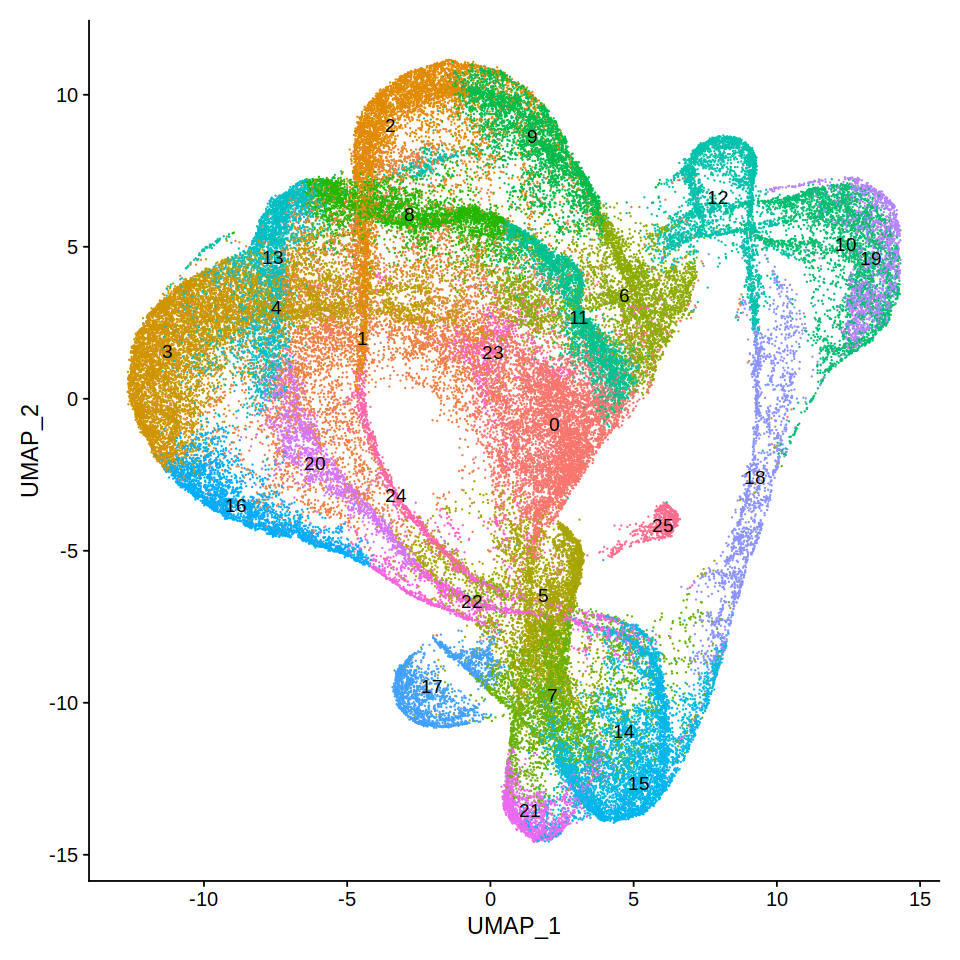

In [23]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, label=TRUE)+NoLegend()

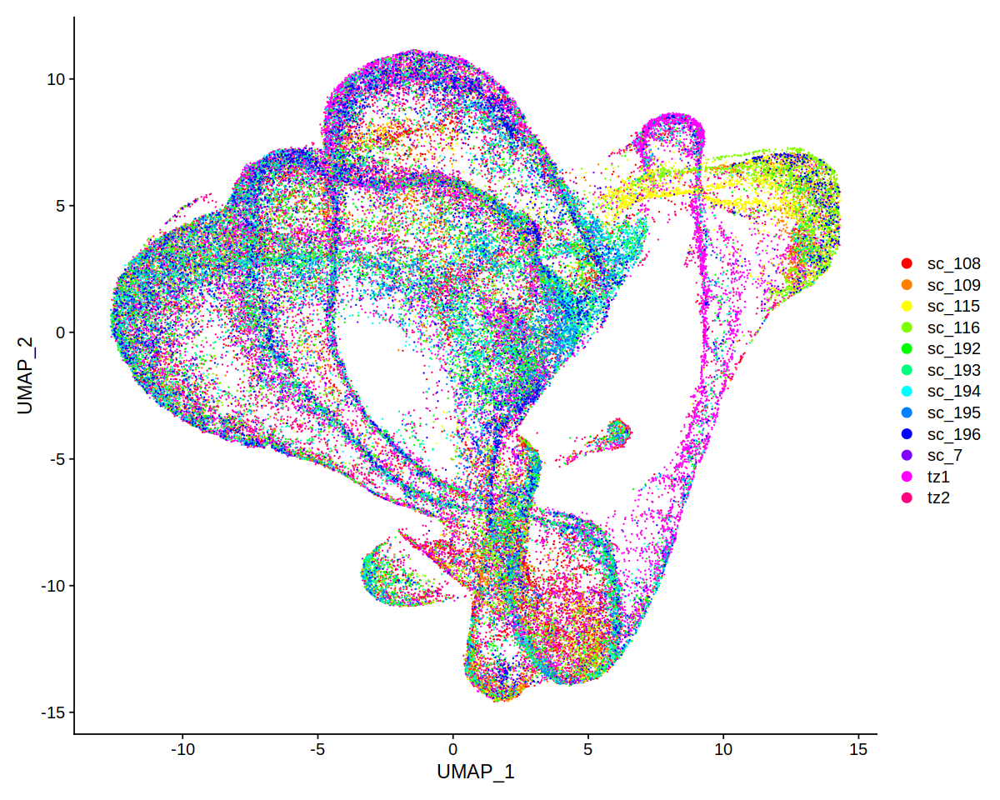

In [24]:
options(repr.plot.width=10, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "orig.ident", cols= rainbow(12))

In [ ]:
saveRDS(rc.integrated, file = "./scRNA-seq/Integrated_Objects/Rice_12S_WT_atlas_20221117_seu3.rds")

In [25]:
rc.integrated$log_nCount_RNA <- log(rc.integrated$nCount_RNA)

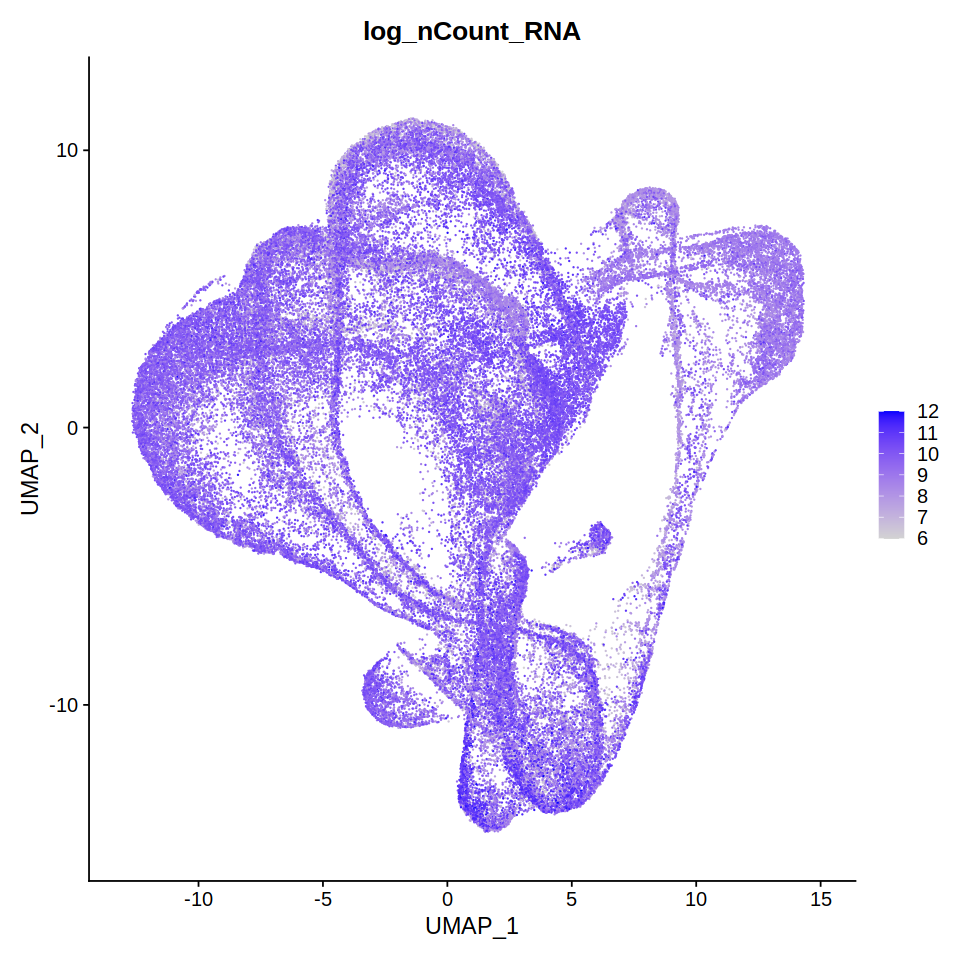

In [26]:
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, features = "log_nCount_RNA")

## Time zone anno

In [27]:
load("./Meta_data/Root_bulk_rice_curated.RD")

In [28]:
nrow(time_MSU)

[1] 1500

In [29]:
head(time_MSU)

,Meristem,Elongation,Maturation1,Maturation2
,<dbl>,<dbl>,<dbl>,<dbl>
LOC-Os01g01010,3.8171504,3.6033069,3.9269744,4.070318
LOC-Os01g01019,-0.1014923,0.5701927,0.8801323,0.895213
LOC-Os01g01030,3.8802457,3.0066841,3.3899125,3.328385
LOC-Os01g01040,5.3393929,7.0232611,7.1812127,6.560164
LOC-Os01g01050,2.6873846,2.4492419,4.2526756,4.067421
LOC-Os01g01060,9.3628724,7.8553273,6.4893337,5.912760


In [30]:
# Extract matrix of integrated-batch-corrected expression value 
rc <- as.matrix(rc.integrated@assays$integrated@data)

In [31]:
# Merge the reference expression profile with the normalized expression matrix of our sample  

merge.rownames <- function (x,y){
  dat <- merge(x = x, y = y, by = "row.names")
  rownames(dat) <- dat$Row.names
  dat <- dat[,-1]
  return(dat)
}

time <- Reduce(merge.rownames, list(time_MSU,rc))

In [32]:
## Number of genes
nrow(time)

[1] 1110

In [33]:
head(time)

,Meristem,Elongation,Maturation1,Maturation2,AAACCCAAGAATACAC_1,AAACCCAAGAGTTCGG_1,AAACCCAAGGTAGCAC_1,AAACCCAAGTGATGGC_1,AAACCCAAGTGGAAGA_1,AAACCCAAGTTGCTCA_1,...,TTTGGAGGTTCACGAT_12,TTTGGAGTCCCGTTCA_12,TTTGGAGTCGAACGGA_12,TTTGGTTGTACCTAGT_12,TTTGGTTGTGACTCTA_12,TTTGGTTGTTCGGTCG_12,TTTGGTTTCACCCTTG_12,TTTGTTGAGAAGGATG_12,TTTGTTGAGGATTTAG_12,TTTGTTGCATTCTCCG_12
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
LOC-Os01g01010,3.8171504,3.6033069,3.9269744,4.070318,-0.16539259,-0.1566606,-0.1544584,-0.2539519,-0.2798065,-0.1795019,...,0.36658185,-0.01899874,-0.15512018,-0.20922695,-0.174582428,-0.3825783,-0.1184442,0.11194912,-0.1886373,-0.115706682
LOC-Os01g01019,-0.1014923,0.5701927,0.8801323,0.895213,-0.11405769,-0.1079740,-0.1064359,-0.1748970,-0.1925809,-0.1238417,...,-0.06274370,-0.09550164,-0.04248936,-0.15843951,8.600436939,-0.3794739,-0.1356814,-0.51058476,-0.7206320,-0.072010923
LOC-Os01g01030,3.8802457,3.0066841,3.3899125,3.328385,-0.15887535,-0.1506049,-0.1485180,-0.2424332,-0.2667473,-0.1722251,...,-0.14971078,-0.13922222,-0.13570241,4.30622602,-0.003293015,-0.1495166,5.7988991,-0.32756596,-0.2510060,-0.007144560
LOC-Os01g01040,5.3393929,7.0232611,7.1812127,6.560164,-0.44279801,-0.4109265,-0.4027968,-0.1596220,0.4495326,0.7937728,...,-0.03305562,2.30353379,-0.30791683,-0.04367318,-0.119181227,-0.3277435,-0.1265569,0.03827131,1.5037052,0.007877556
LOC-Os01g01050,2.6873846,2.4492419,4.2526756,4.067421,-0.17543230,-0.1678215,-0.1658997,-0.2519516,2.3777771,-0.1877001,...,-0.18220343,0.14917134,0.06987034,0.94042339,-0.284121127,-0.2629619,-0.2107251,-0.26041142,-0.1918925,-0.129593260
LOC-Os01g01060,9.3628724,7.8553273,6.4893337,5.912760,-0.03083863,-1.1268763,-1.1174055,-1.4572282,-1.5154831,-1.2204200,...,-0.59577470,-0.75737336,-1.04660093,-1.17044143,-0.663788870,-1.4995053,-1.2563877,-0.94665575,-1.1891626,-0.814809660


In [34]:
# Prepare customized label name (optional)
time_label=c("Meristem","Elongation","Maturation1","Maturation2")

In [35]:
# Calculating the correlation coefficient of each cell to each reference expression profile and annotate the cell as the label that it has the highest correlation coefficient with.  
time_stat <- suppressWarnings(sapply(5:ncol(time), function(i) sapply(1:4, function(j) cor.test(time[,i],time[,j],method = "pearson")[c(3,4)])))
time_cor <- time_stat[seq(2,nrow(time_stat),2),]
time_pvalue <- time_stat[seq(1,nrow(time_stat)-1,2),]
time_max <- sapply(1:(ncol(time)-4), function(i) max(as.numeric(time_cor[,i])))
time_ident <- sapply(1:(ncol(time)-4), function(i) time_label[which(as.numeric(time_cor[,i])==max(as.numeric(time_cor[,i])))])
time_maxp <- sapply(1:(ncol(time)-4), function(i) as.numeric(time_pvalue[,i])[which(as.numeric(time_cor[,i])==max(as.numeric(time_cor[,i])))])
names(time_max) <- time_ident

In [36]:
# Store the annotation, correlation coefficient and the p-value in Seurat object
rc.integrated@meta.data$timezone.ID.P <- as.character(time_ident)
rc.integrated@meta.data$timezone.cor.P <- time_max
rc.integrated@meta.data$timezone.pvalue.P <- time_maxp

# In case there is cell with insufficient information for annotation, label them as "unknown"
rc.integrated@meta.data$timezone.ID.P[which(rc.integrated@meta.data$timezone.ID.P=='character(0)')]="unknown"

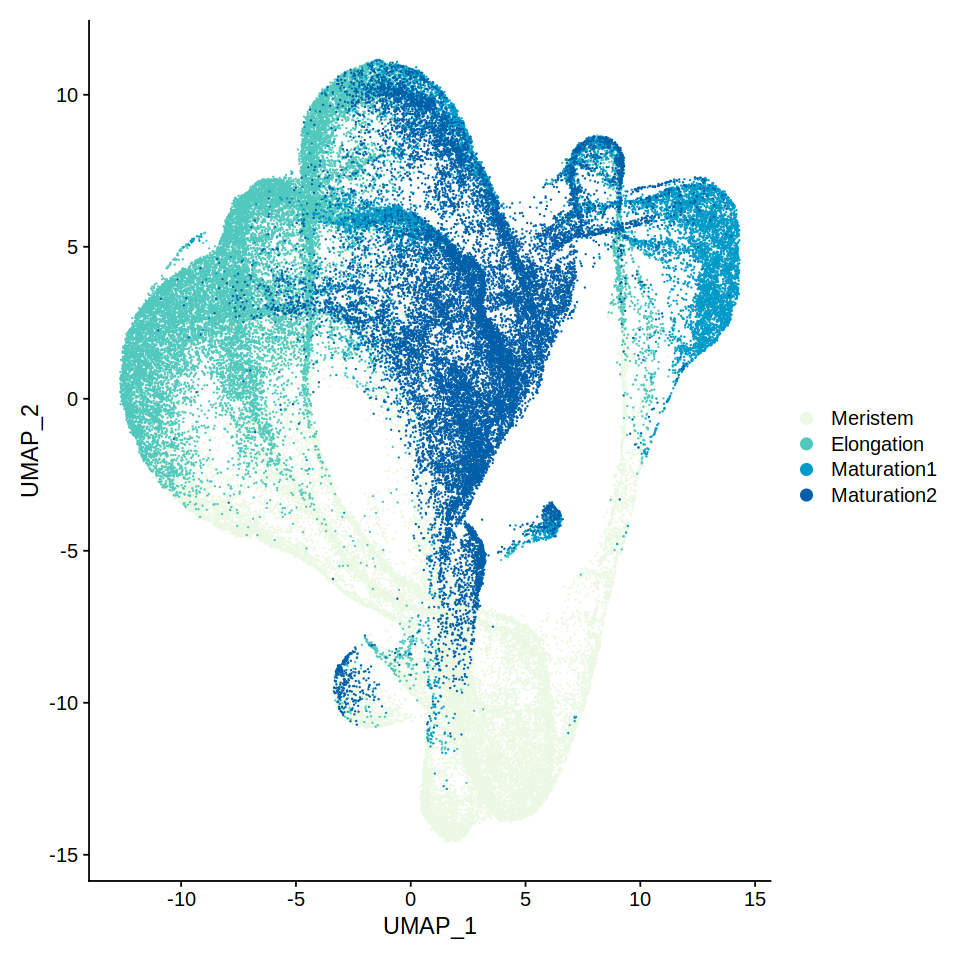

In [37]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "timezone.ID.P", order = c("Maturation2","Maturation1","Elongation","Meristem"),cols = c("#ebf8e3", "#51c8bd", "#009ac8", "#005fa8"))

## Sample correlation

In [38]:
table(rc.integrated$orig.ident)


sc_108 sc_109 sc_115 sc_116 sc_192 sc_193 sc_194 sc_195 sc_196   sc_7    tz1 
  4995   4499   3381   5188   6650   5296   4608   4802   4549   3042  15979 
   tz2 
 16754 

In [39]:
rc.integrated$geno <- rc.integrated$orig.ident
rc.integrated$geno <- gsub("sc_7","X.Kitaake",rc.integrated$geno)
rc.integrated$geno <- gsub("sc_108","X.Kitaake",rc.integrated$geno)
rc.integrated$geno <- gsub("sc_109","X.Kitaake",rc.integrated$geno)
rc.integrated$geno <- gsub("sc_115","X.Kitaake",rc.integrated$geno)
rc.integrated$geno <- gsub("sc_116","X.Kitaake",rc.integrated$geno)
rc.integrated$geno <- gsub("sc_192","X.Kitaake",rc.integrated$geno)
rc.integrated$geno <- gsub("sc_193","X.Kitaake",rc.integrated$geno)
rc.integrated$geno <- gsub("sc_194","X.Kitaake",rc.integrated$geno)
rc.integrated$geno <- gsub("sc_195","X.Kitaake",rc.integrated$geno)
rc.integrated$geno <- gsub("sc_196","X.Kitaake",rc.integrated$geno)
rc.integrated$geno <- gsub("tz1","ZH11",rc.integrated$geno)
rc.integrated$geno <- gsub("tz2","ZH11",rc.integrated$geno)


In [40]:
m1 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_7")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_7")])
m2 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_108")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_108")])
m3 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_109")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_109")])
m4 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_115")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_115")])
m5 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_116")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_116")])
m6 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_192")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_192")])
m7 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_193")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_193")])
m8 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_194")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_194")])
m9 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_195")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_195")])
m10 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_196")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="sc_196")])
m11 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="tz1")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="tz1")])
m12 <- rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="tz2")]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident=="tz2")])

Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.2 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.1 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.3 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.6 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.3 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.1 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.2 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.1 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 3.9 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 4.1 GiB”


In [41]:
dat <- data.frame(sc_7_Kitaake_WT_2days=m1, sc_108_Kitaake_WT_4days=m2, sc_109_Kitaake_WT_4days=m3, sc_115_Kitaake_WT_3days=m4, sc_116_Kitaake_WT_3days=m5,
                 sc_192_Kitaake_WT_4days=m6, sc_193_Kitaake_WT_4days=m7,sc_194_Kitaake_WT_4days=m8,sc_195_Kitaake_WT_4days=m9,sc_196_Kitaake_WT_4days=m10,
                 tz1_ZH11_WT_5days=m11,tz2_ZH11_WT_5days=m12)

Warning message in brewer.pal(11, "YlOrRd"):
“n too large, allowed maximum for palette YlOrRd is 9
Returning the palette you asked for with that many colors
”


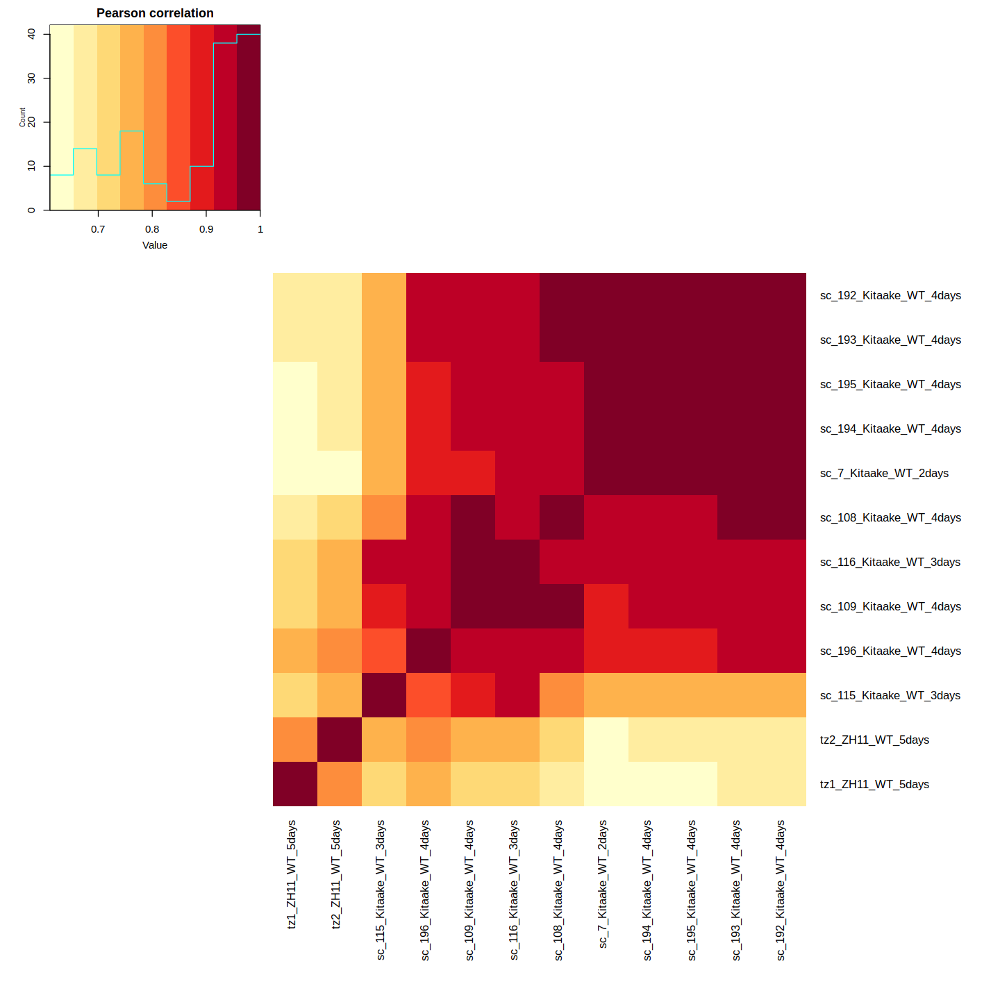

In [42]:
options(repr.plot.width=12, repr.plot.height=12)
##The agglomeration method to be used. This should be (an unambiguous abbreviation of) one of "ward.D", "ward.D2", "single", "complete", "average" (= UPGMA), "mcquitty" (= WPGMA), "median" (= WPGMC) or "centroid" (= UPGMC).
##The distance measure to be used. This must be one of "euclidean", "maximum", "manhattan", "canberra", "binary" or "minkowski". Any unambiguous substring can be given.
gplots::heatmap.2(cor(dat,method = "pearson"),col = brewer.pal(11,"YlOrRd"), 
          hclustfun = function(x) hclust(x, method = "median"), dendrogram="none",
          distfun = function(x) dist(x, method = "euclidean"), key.title = "Pearson correlation", trace = "none",cexCol = 1, cexRow = 1, margin=c(14,14),Colv=TRUE, Rowv = TRUE)

## Load the integrated objects (2023/11/09)

In [6]:
rc.integrated <- readRDS("./scRNA-seq/Integrated_Objects/Rice_12S_WT_atlas_20221117_seu3.rds")

In [13]:
head(rc.integrated@assays$integrated@data)

,AAACCCAAGAATACAC_1,AAACCCAAGAGTTCGG_1,AAACCCAAGGTAGCAC_1,AAACCCAAGTGATGGC_1,AAACCCAAGTGGAAGA_1,AAACCCAAGTTGCTCA_1,AAACCCACACAAGTGG_1,AAACCCACACAGGATG_1,AAACCCACATCAGCGC_1,AAACCCACATTGGCAT_1,...,TTTGGAGGTTCACGAT_12,TTTGGAGTCCCGTTCA_12,TTTGGAGTCGAACGGA_12,TTTGGTTGTACCTAGT_12,TTTGGTTGTGACTCTA_12,TTTGGTTGTTCGGTCG_12,TTTGGTTTCACCCTTG_12,TTTGTTGAGAAGGATG_12,TTTGTTGAGGATTTAG_12,TTTGTTGCATTCTCCG_12
LOC-Os04g46810,-3.489592,-4.076481,-4.064658,-4.107090,-4.281857,-4.181265,-4.3819844,-3.979456,-1.590159,-4.0896639,...,-4.203015,-3.38290498,-1.417949,10.000000,-2.8710460,10.000000,-3.826596,-0.8019649,10.0000000,-2.539364
LOC-Os07g31610,-1.532924,-1.510818,-1.505259,-1.756248,-1.818377,10.000000,-1.7795389,-1.655355,-1.776116,-1.7482597,...,-1.671509,-0.87590624,-1.168881,-1.489915,-1.4419265,-1.770225,-1.648871,-1.8791736,-1.5213221,-1.395994
LOC-Os10g39890,-1.496355,-1.474577,-1.469100,-1.717074,-1.778787,10.000000,-1.7401902,-1.617175,-1.736791,-1.7091515,...,-1.633234,-1.42127324,-1.334040,-1.572713,-1.3881642,-1.689367,-1.650550,-1.5620401,-1.0153073,-1.391670
LOC-Os07g35860,-1.720539,-1.695625,-1.689341,-1.963804,-2.028037,10.000000,-1.9880863,-1.856050,-1.984532,-1.9554223,...,-1.610226,-0.08878541,-1.512589,-1.657318,-1.6891500,-1.895596,-2.163233,-1.8362769,0.2664263,-1.757190
LOC-Os06g22919,-1.510187,-1.487253,-1.481480,-1.739866,-1.802894,10.000000,-0.7884869,-1.636628,-1.760070,-0.6200898,...,-1.713795,-1.23395939,-1.555474,-1.555924,-0.9784831,-1.692611,-1.540442,-1.5317131,-0.7866092,-1.305740
LOC-Os02g44310,-5.422435,-3.098616,-4.656418,-5.437539,-4.585308,-5.607357,-5.6665138,-5.490333,7.762616,-4.6710595,...,-5.739790,-5.38374304,7.562930,10.000000,-3.4914344,10.000000,-3.704694,10.0000000,10.0000000,-1.933807


In [14]:
head(rc.integrated@assays$SCT@data)

  [[ suppressing 34 column names ‘AAACCCAAGAATACAC_1’, ‘AAACCCAAGAGTTCGG_1’, ‘AAACCCAAGGTAGCAC_1’ ... ]]



6 x 79743 sparse Matrix of class "dgCMatrix"
                                                                               
LOC-Os01g01010 .         . . . .         .         .        .         .        
LOC-Os01g01019 .         . . . .         .         .        .         .        
LOC-Os01g01030 .         . . . .         .         .        .         .        
LOC-Os01g01040 .         . . . 0.6931472 0.6931472 .        0.6931472 0.6931472
LOC-Os01g01050 .         . . . .         .         .        0.6931472 .        
LOC-Os01g01060 0.6931472 . . . .         .         1.791759 2.4849066 .        
                                                                      
LOC-Os01g01010 .         . .         .        . .        .         . .
LOC-Os01g01019 .         . .         .        . .        .         . .
LOC-Os01g01030 .         . .         .        . .        .         . .
LOC-Os01g01040 .         . 0.6931472 .        . 1.098612 0.6931472 . .
LOC-Os01g01050 .         . .         .  

In [15]:
head(rc.integrated@assays$RNA@counts)

  [[ suppressing 34 column names ‘AAACCCAAGAATACAC_1’, ‘AAACCCAAGAGTTCGG_1’, ‘AAACCCAAGGTAGCAC_1’ ... ]]



6 x 79743 sparse Matrix of class "dgCMatrix"
                                                                               
LOC-Os01g01010 . . . . . .  .  . . . . . . . . . . . . .  . . . . . 1 . . . . .
LOC-Os01g01019 . . . . . .  .  . . . . . . . . . . . . .  . . . . . . . . . . .
LOC-Os01g01030 . . . . . .  .  . . . . . . . . . . . . .  . . . . . . . . . . .
LOC-Os01g01040 . . . 1 3 1  .  1 2 1 . 1 . . 1 2 . . 1 .  2 . . . . 4 1 2 1 1 .
LOC-Os01g01050 . . . . 1 .  .  1 . . . . . . . . . . . .  . . . . . . . . . . .
LOC-Os01g01060 1 . . . . . 13 15 . 2 . 1 3 . . . . . . . 18 1 . . . . . 1 . . .
                           
LOC-Os01g01010 . . . ......
LOC-Os01g01019 . . . ......
LOC-Os01g01030 . . . ......
LOC-Os01g01040 . 2 . ......
LOC-Os01g01050 . . 1 ......
LOC-Os01g01060 . . 2 ......

 .....suppressing 79709 columns in show(); maybe adjust 'options(max.print= *, width = *)'
 ..............................

In [16]:
## Normalized values (log normalization)
head(rc.integrated@assays$RNA@data)

  [[ suppressing 34 column names ‘AAACCCAAGAATACAC_1’, ‘AAACCCAAGAGTTCGG_1’, ‘AAACCCAAGGTAGCAC_1’ ... ]]



6 x 79743 sparse Matrix of class "dgCMatrix"
                                                                               
LOC-Os01g01010 . . . . . .  .  . . . . . . . . . . . . .  . . . . . 1 . . . . .
LOC-Os01g01019 . . . . . .  .  . . . . . . . . . . . . .  . . . . . . . . . . .
LOC-Os01g01030 . . . . . .  .  . . . . . . . . . . . . .  . . . . . . . . . . .
LOC-Os01g01040 . . . 1 3 1  .  1 2 1 . 1 . . 1 2 . . 1 .  2 . . . . 4 1 2 1 1 .
LOC-Os01g01050 . . . . 1 .  .  1 . . . . . . . . . . . .  . . . . . . . . . . .
LOC-Os01g01060 1 . . . . . 13 15 . 2 . 1 3 . . . . . . . 18 1 . . . . . 1 . . .
                           
LOC-Os01g01010 . . . ......
LOC-Os01g01019 . . . ......
LOC-Os01g01030 . . . ......
LOC-Os01g01040 . 2 . ......
LOC-Os01g01050 . . 1 ......
LOC-Os01g01060 . . 2 ......

 .....suppressing 79709 columns in show(); maybe adjust 'options(max.print= *, width = *)'
 ..............................

In [7]:
## How does a Seurat object look like?
rc.integrated

An object of class Seurat 
96918 features across 79743 samples within 3 assays 
Active assay: integrated (19395 features, 19395 variable features)
 2 other assays present: RNA, SCT
 5 dimensional reductions calculated: pca, umap, umap_50, umap_3D, umap_2D

In [17]:
## Annotations
head(rc.integrated@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,nCount_spliced_RNA,nFeature_spliced_RNA,nCount_unspliced_RNA,nFeature_unspliced_RNA,percent.mt,percent.cp,nCount_SCT,...,score.anno,consensus.anno,new_ref,final.anno.P,final.anno.cor.P,final.anno.pvalue.P,celltype.anno,time.anno,celltype.fine.anno,integrated_snn_res.500
,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,...,<fct>,<fct>,<chr>,<chr>,<dbl>,<dbl>,<fct>,<chr>,<fct>,<fct>
AAACCCAAGAATACAC_1,tz2,7533,2277,7235,2203,298,141,0.46462233,0.013274924,9654,...,Endodermis,Endodermis,Maturation_Endodermis,Maturation_Endodermis,0.9310545,1.228848e-88,Endodermis,Maturation,Endodermis,341
AAACCCAAGAGTTCGG_1,tz2,6436,1952,6069,1868,367,131,0.52827843,0.000000000,9882,...,Sclerenchyma,Sclerenchyma,Maturation_Sclerenchyma,Maturation_Sclerenchyma,0.8373472,7.925984e-54,Sclerenchyma,Maturation,Sclerenchyma,6
AAACCCAAGGTAGCAC_1,tz2,6178,2392,5902,2268,276,182,0.72839107,0.016186468,9468,...,Exodermis,Cortex,Maturation_Cortex,Elongation_Exodermis,0.4728577,1.548340e-12,Exodermis,Elongation,Exodermis,2067
AAACCCAAGTGATGGC_1,tz2,28987,4895,27735,4684,1252,422,0.42087832,0.000000000,10750,...,Exodermis,Exodermis,Elongation_Exodermis,Elongation_Exodermis,0.8639942,6.486327e-61,Exodermis,Elongation,Exodermis,750
AAACCCAAGTGGAAGA_1,tz2,41734,6475,39910,6181,1824,612,0.06469545,0.002396128,10108,...,Exodermis,Exodermis,Maturation_Exodermis,Maturation_Exodermis,0.8892509,3.514207e-69,Exodermis,Maturation,Exodermis,2602
AAACCCAAGTTGCTCA_1,tz2,9579,3099,9049,2918,530,290,0.48021714,0.010439503,9931,...,Trichoblast,Trichoblast,Maturation_Trichoblast,Maturation_Trichoblast,0.9212941,3.704953e-83,Trichoblast,Maturation,Trichoblast,350


In [19]:
colnames(rc.integrated@meta.data)

[1] "orig.ident"                         "nCount_RNA"                        
 [3] "nFeature_RNA"                       "nCount_spliced_RNA"                
 [5] "nFeature_spliced_RNA"               "nCount_unspliced_RNA"              
 [7] "nFeature_unspliced_RNA"             "percent.mt"                        
 [9] "percent.cp"                         "nCount_SCT"                        
[11] "nFeature_SCT"                       "pANN_0.25_0.15_2850"               
[13] "DF.classifications_0.25_0.15_2850"  "nCount_spliced_SCT"                
[15] "nFeature_spliced_SCT"               "nCount_unspliced_SCT"              
[17] "nFeature_unspliced_SCT"             "SCT_snn_res.0.5"                   
[19] "seurat_clusters"                    "pANN_0.25_0.15_2547"               
[21] "DF.classifications_0.25_0.15_2547"  "pANN_0.25_0.15_205"                
[23] "DF.classifications_0.25_0.15_205"   "celltype.plate.ID"                 
[25] "timezone.ID"                        "celltype.plate.cor"                
[27] "timezone.cor"                       "celltype.plate.pvalue"             
[29] "timezone.pvalue"                    "celltype.field.ID"                 
[31] "celltype.field.cor"                 "celltype.field.pvalue"             
[33] "celltype.plate.ID.P"                "timezone.ID.P"                     
[35] "celltype.plate.cor.P"               "timezone.cor.P"                    
[37] "celltype.plate.pvalue.P"            "timezone.pvalue.P"                 
[39] "celltype.field.ID.P"                "celltype.field.cor.P"              
[41] "celltype.field.pvalue.P"            "SCT_snn_res.50"                    
[43] "seucluster.celltype.plate.cor.P"    "seucluster.celltype.plate.pvalue.P"
[45] "seucluster.celltype.plate.ID.P"     "seucluster.celltype.field.cor.P"   
[47] "seucluster.celltype.field.pvalue.P" "seucluster.celltype.field.ID.P"    
[49] "seucluster.timezone.cor.P"          "seucluster.timezone.pvalue.P"      
[51] "seucluster.timezone.ID.P"           "seucluster.celltype.plate.cor"     
[53] "seucluster.celltype.plate.pvalue"   "seucluster.celltype.plate.ID"      
[55] "seucluster.celltype.field.cor"      "seucluster.celltype.field.pvalue"  
[57] "seucluster.celltype.field.ID"       "seucluster.timezone.cor"           
[59] "seucluster.timezone.pvalue"         "seucluster.timezone.ID"            
[61] "pANN_0.25_0.15_166"                 "DF.classifications_0.25_0.15_166"  
[63] "pANN_0.25_0.15_75"                  "DF.classifications_0.25_0.15_75"   
[65] "SCT_snn_res.5"                      "pANN_0.25_0.15_93"                 
[67] "DF.classifications_0.25_0.15_93"    "pANN_0.25_0.15_222"                
[69] "DF.classifications_0.25_0.15_222"   "pANN_0.25_0.15_371"                
[71] "DF.classifications_0.25_0.15_371"   "pANN_0.25_0.15_232"                
[73] "DF.classifications_0.25_0.15_232"   "pANN_0.25_0.15_174"                
[75] "DF.classifications_0.25_0.15_174"   "pANN_0.25_0.15_190"                
[77] "DF.classifications_0.25_0.15_190"   "pANN_0.25_0.15_170"                
[79] "DF.classifications_0.25_0.15_170"   "integrated_snn_res.0.5"            
[81] "DF.classifications"                 "log_nCount_RNA"                    
[83] "geno"                               "integrated_snn_res.2"              
[85] "score.crude.anno"                   "integrated_snn_res.300"            
[87] "score.anno"                         "consensus.anno"                    
[89] "new_ref"                            "final.anno.P"                      
[91] "final.anno.cor.P"                   "final.anno.pvalue.P"               
[93] "celltype.anno"                      "time.anno"                         
[95] "celltype.fine.anno"                 "integrated_snn_res.500"

In [18]:
table(rc.integrated$orig.ident)


sc_108 sc_109 sc_115 sc_116 sc_192 sc_193 sc_194 sc_195 sc_196   sc_7    tz1 
  4995   4499   3381   5188   6650   5296   4608   4802   4549   3042  15979 
   tz2 
 16754 

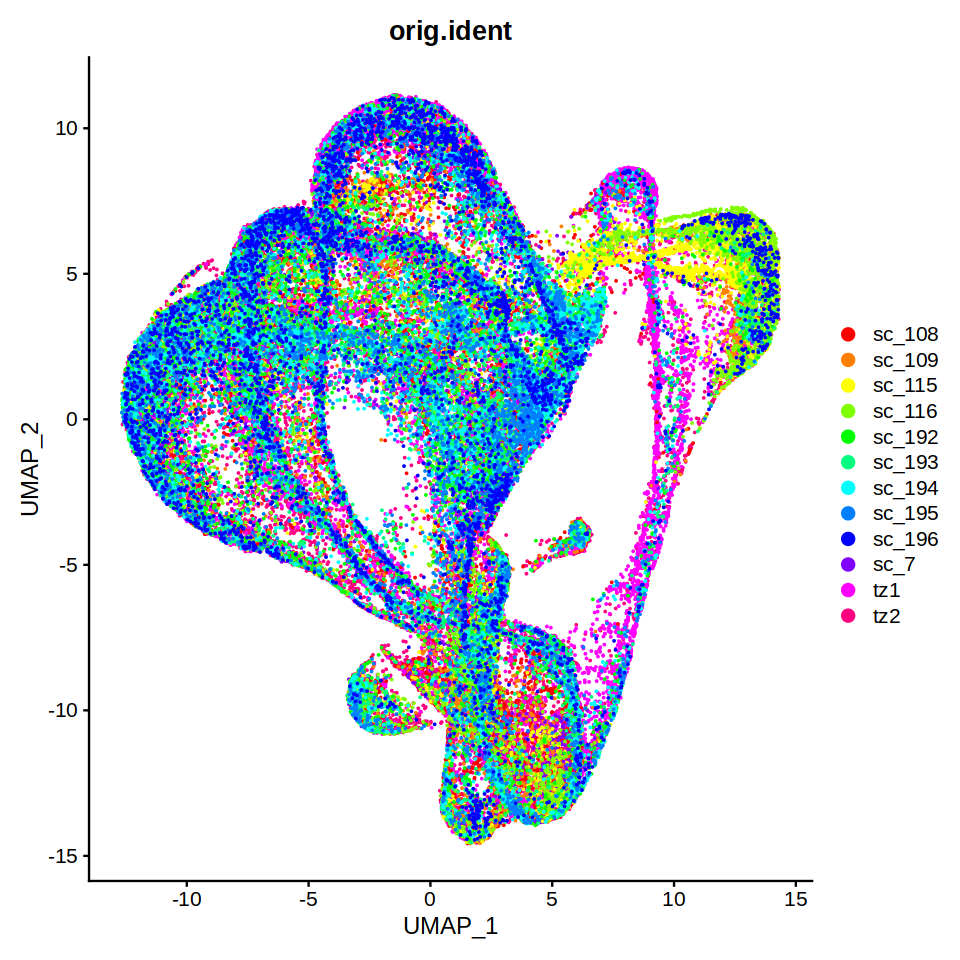

In [20]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "orig.ident", cols= rainbow(12))

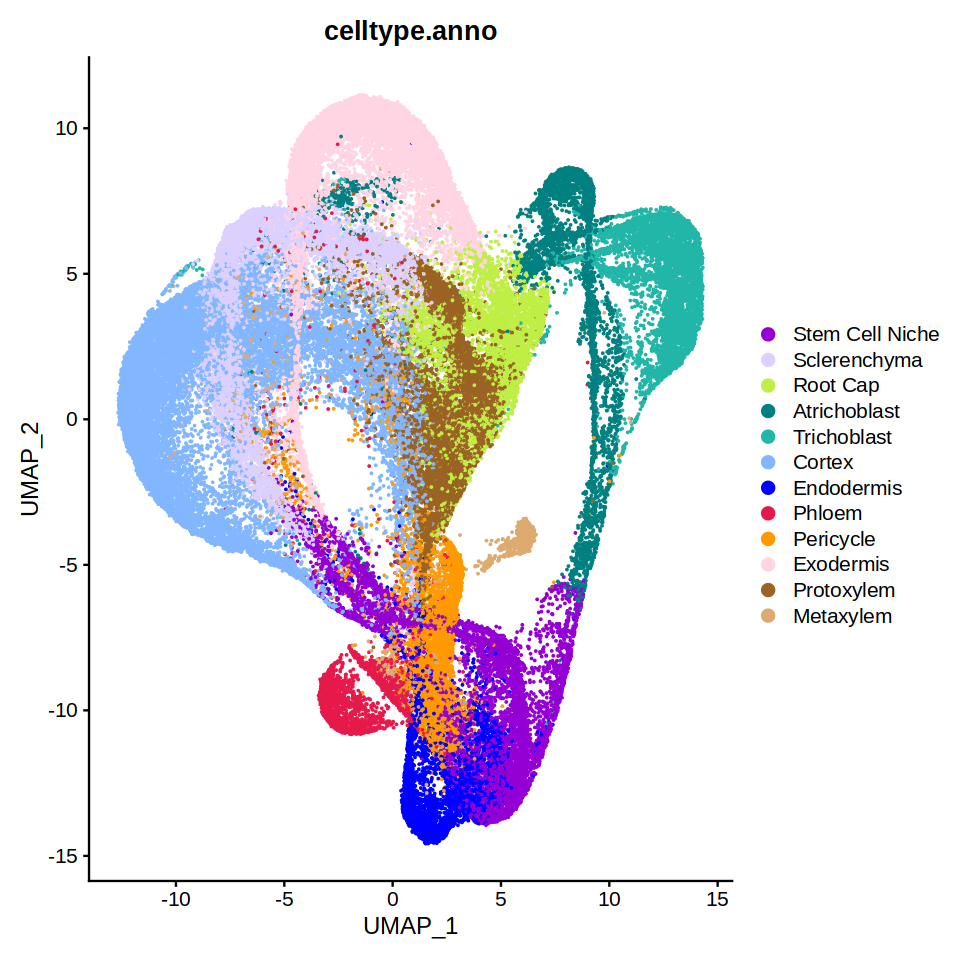

In [9]:
## Plot cell type
order <- c("Stem Cell Niche", "Sclerenchyma", "Columella", "Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Vascular Tissue","Pericycle","Exodermis","Epidermis", "Protoxylem", "Metaxylem", "Unknown")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#dd77ec", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$celltype.anno <- factor(rc.integrated$celltype.anno , levels = order[sort(match(unique(rc.integrated$celltype.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$celltype.anno),order))]
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.anno", cols = color)+ggtitle("celltype.anno")

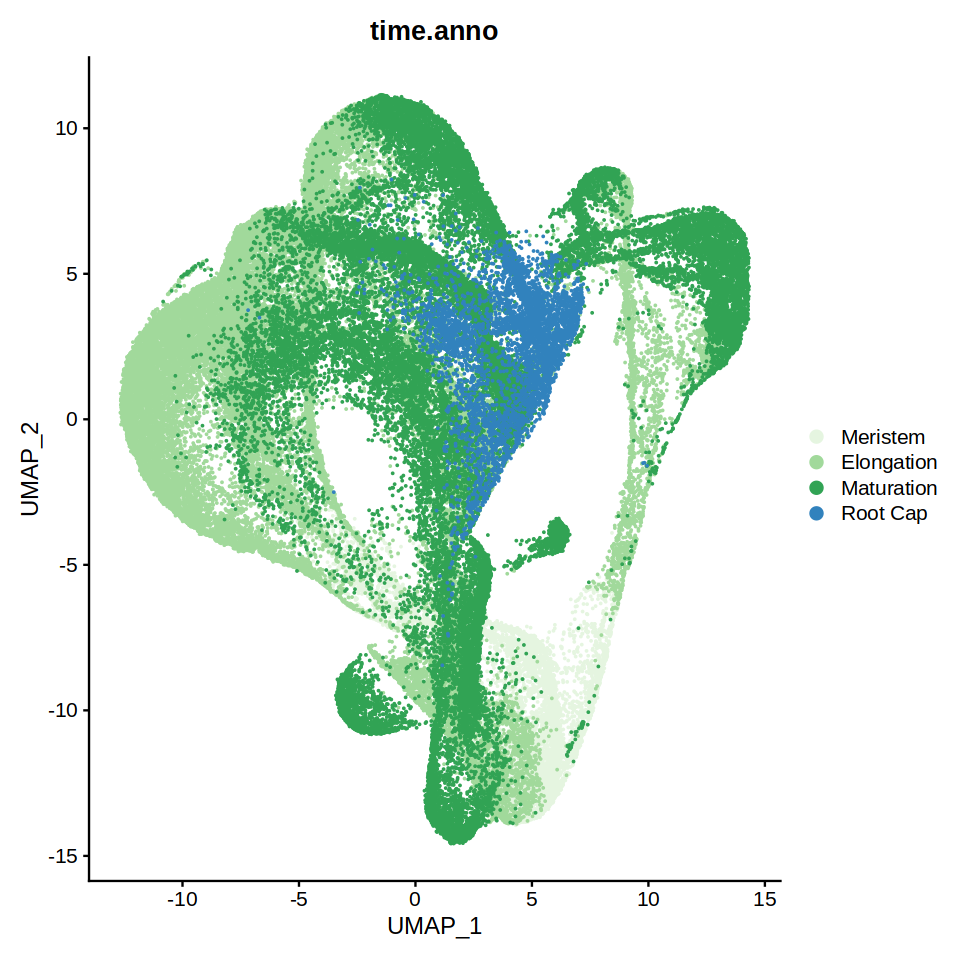

In [10]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "time.anno",order = c("Root Cap","Maturation","Elongation","Meristem"),cols = c("#e5f5e0", "#a1d99b", "#31a354", "#3182bd"))

## Cell type anno with known marker z-score

In [43]:
zscore <- function(x){(x-mean(x))/sd(x)}
known.good.markers <- read.csv("./Meta_data/Potential_good_markers_for_annotation_20221129_Final.csv")
known.good.markers$Gene.ID <- gsub("^LOC_","LOC-",known.good.markers$Gene.ID)

In [44]:
known.good.markers

Gene.ID,Cell.type,Source,Atlas.Expression
<chr>,<chr>,<chr>,<chr>
LOC-Os01g14650,Atrichoblast,"Zhang et al., Nature Comm., 2021",Confirmed
LOC-Os01g50820,Atrichoblast,Benfey Lab,Confirmed
LOC-Os01g64840,Atrichoblast,Benfey Lab,Confirmed
LOC-Os01g19220,Cortex,Benfey Lab,Confirmed
LOC-Os03g04310,Cortex,Benfey Lab,Confirmed
LOC-Os05g33080,Cortex,Benfey Lab,Confirmed
LOC-Os06g30730,Cortex,Benfey Lab,Confirmed
LOC-Os04g46810,Cortex,"Liu et al., Molecular Plant, 2021, Fig. 1E",Confirmed
LOC-Os01g15810,Endodermis,Benfey Lab,Confirmed


In [45]:
#known.good.markers$Cell.type <- gsub("Epidermis, Root cap", "Root Cap", known.good.markers$Cell.type, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
#known.good.markers$Celltype <- gsub("Epidermis", "Atrichoblast", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
#known.good.markers$Cell.type <- gsub("Early Metaxylem", "Xylem", known.good.markers$Cell.type, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
#known.good.markers$Celltype <- gsub("Late Metaxylem", "Xylem", known.good.markers$Celltype, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Cell.type <- gsub("Meristem", "Stem cell niche", known.good.markers$Cell.type, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
#known.good.markers$Cell.type <- gsub("QC", "Stem cell niche", known.good.markers$Cell.type, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);
known.good.markers$Cell.type <- gsub("Root Cap junction", "Root Cap", known.good.markers$Cell.type, ignore.case = FALSE, perl = FALSE,fixed = T, useBytes = FALSE);

In [46]:
known.good.markers

Gene.ID,Cell.type,Source,Atlas.Expression
<chr>,<chr>,<chr>,<chr>
LOC-Os01g14650,Atrichoblast,"Zhang et al., Nature Comm., 2021",Confirmed
LOC-Os01g50820,Atrichoblast,Benfey Lab,Confirmed
LOC-Os01g64840,Atrichoblast,Benfey Lab,Confirmed
LOC-Os01g19220,Cortex,Benfey Lab,Confirmed
LOC-Os03g04310,Cortex,Benfey Lab,Confirmed
LOC-Os05g33080,Cortex,Benfey Lab,Confirmed
LOC-Os06g30730,Cortex,Benfey Lab,Confirmed
LOC-Os04g46810,Cortex,"Liu et al., Molecular Plant, 2021, Fig. 1E",Confirmed
LOC-Os01g15810,Endodermis,Benfey Lab,Confirmed


In [47]:
## No markers not shared
which(is.na(match(known.good.markers$Gene.ID,rownames(rc.integrated@assays$integrated@data))))

integer(0)

In [40]:
#known.good.markers <- known.good.markers[-which(is.na(match(known.good.markers$Gene.ID,rownames(rc.integrated@assays$integrated@data)))),]

In [48]:
known.good.markers <- known.good.markers[-which(known.good.markers$Cell.type == "Xylem"),]

In [49]:
known.good.markers

,Gene.ID,Cell.type,Source,Atlas.Expression
,<chr>,<chr>,<chr>,<chr>
1,LOC-Os01g14650,Atrichoblast,"Zhang et al., Nature Comm., 2021",Confirmed
2,LOC-Os01g50820,Atrichoblast,Benfey Lab,Confirmed
3,LOC-Os01g64840,Atrichoblast,Benfey Lab,Confirmed
4,LOC-Os01g19220,Cortex,Benfey Lab,Confirmed
5,LOC-Os03g04310,Cortex,Benfey Lab,Confirmed
6,LOC-Os05g33080,Cortex,Benfey Lab,Confirmed
7,LOC-Os06g30730,Cortex,Benfey Lab,Confirmed
8,LOC-Os04g46810,Cortex,"Liu et al., Molecular Plant, 2021, Fig. 1E",Confirmed
9,LOC-Os01g15810,Endodermis,Benfey Lab,Confirmed


In [50]:
 as.character(unique(known.good.markers$Cell.type))

[1] "Atrichoblast"    "Cortex"          "Endodermis"      "Exodermis"      
 [5] "Stem cell niche" "Metaxylem"       "Pericycle"       "Phloem"         
 [9] "Protoxylem"      "Root Cap"        "Sclerenchyma"    "Trichoblast"

In [51]:
msc <- c()
for (i in as.character(unique(known.good.markers$Cell.type))){
    if (length(known.good.markers[which(known.good.markers$Cell.type== i),]$Gene.ID)>1){
    msc <- cbind(msc, as.numeric(apply(apply(rc.integrated@assays$integrated@data[known.good.markers[which(known.good.markers$Cell.type== i),]$Gene.ID,], 1, zscore), 1, mean)))       
    } else {
    msc <- cbind(msc, as.numeric(zscore(rc.integrated@assays$integrated@data[known.good.markers[which(known.good.markers$Cell.type== i),]$Gene.ID,])))      
    }

}
colnames(msc) <- as.character(unique(known.good.markers$Cell.type))
rownames(msc) <- colnames(rc.integrated)

In [52]:
# Crude
# Find clusters, here we choose Leiden clustering algorithm with resolution 2. Parameter "algorithm": 1 = original Louvain algorithm; 2 = Louvain algorithm with multilevel refinement; 3 = SLM algorithm; 4 = Leiden algorithm
DefaultAssay(rc.integrated) <- "integrated"
suppressMessages(suppressWarnings(
  rc.integrated <- FindClusters(rc.integrated, resolution = 2, algorithm = 3)
))

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 79743
Number of edges: 2436873

Running smart local moving algorithm...
Maximum modularity in 10 random starts: 0.8963
Number of communities: 62
Elapsed time: 72 seconds


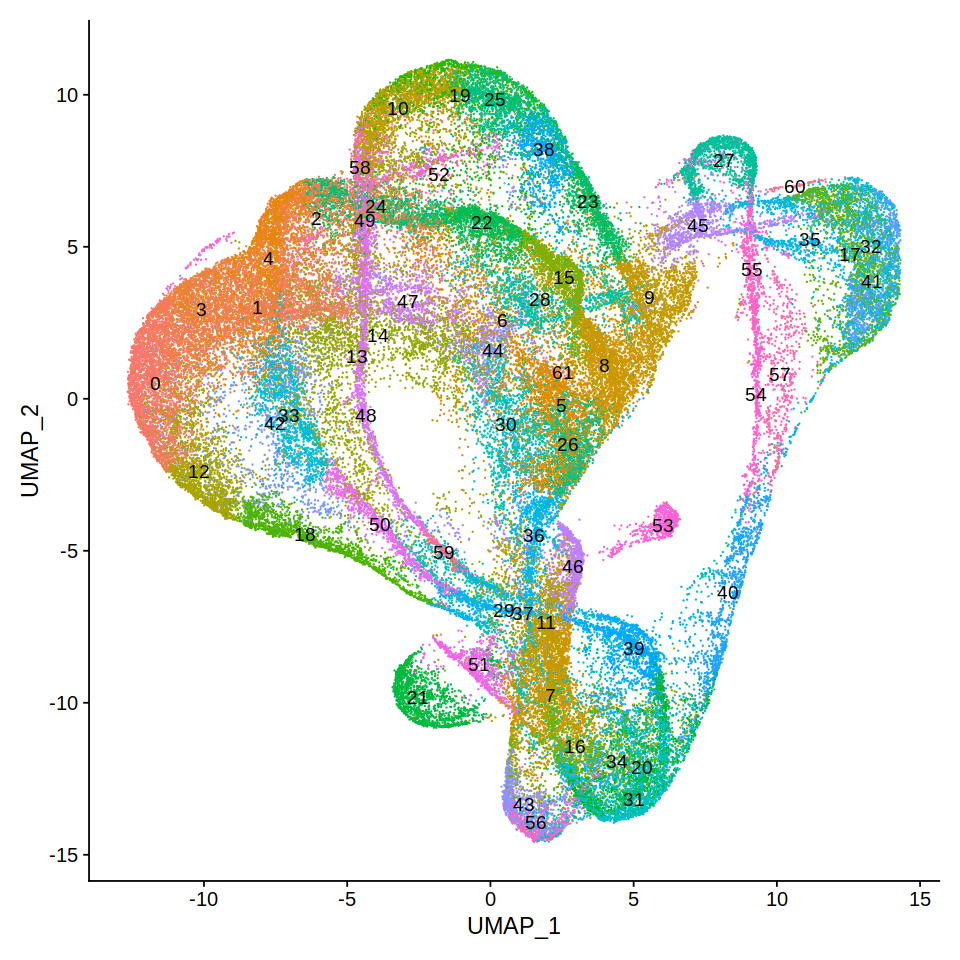

In [53]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", label=TRUE)+NoLegend()

In [54]:
anno <- rc.integrated$seurat_clusters
for (i in unique(rc.integrated$seurat_clusters)){
    if (max(apply(msc[which(rc.integrated$seurat_clusters==i),],2,mean))>0){
        ct <- names(which.max(apply(msc[which(rc.integrated$seurat_clusters==i),],2,mean)))
    } else {
        ct <- "NA"
    }
        anno <- gsub(paste0("^",i,"$"), ct, anno, ignore.case = FALSE, perl = FALSE,fixed = FALSE, useBytes = FALSE)
}

In [55]:
rc.integrated$score.crude.anno <- anno

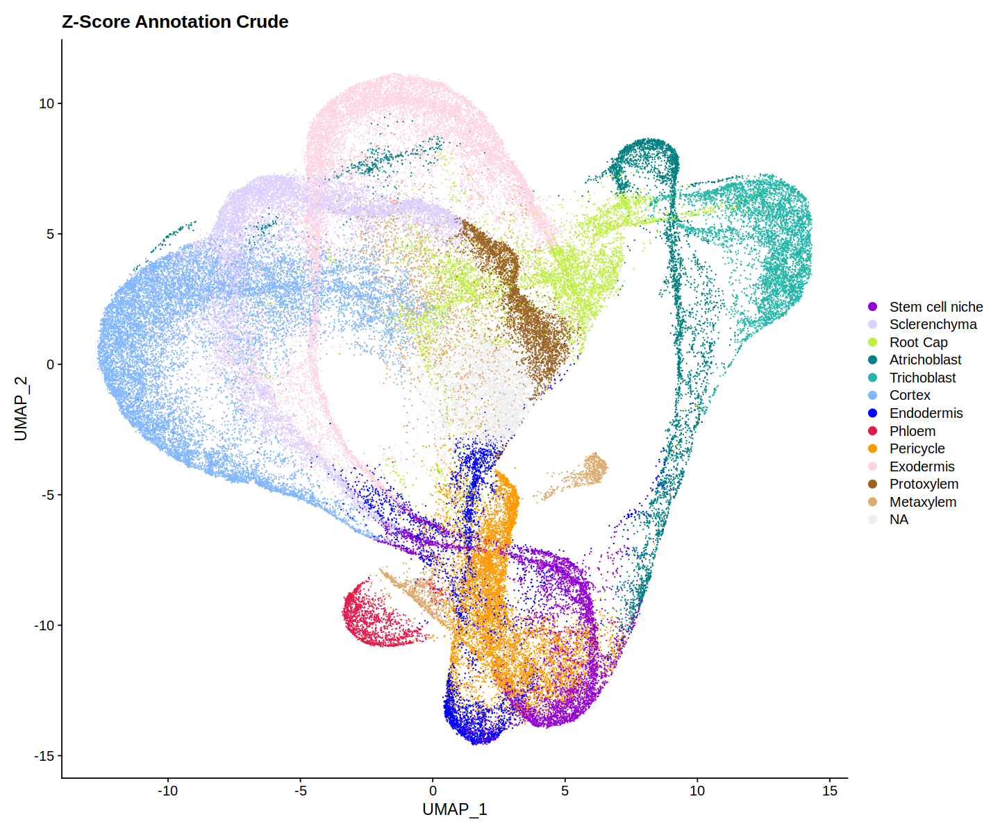

In [56]:
# Plot marker annotation
order <- c("Stem cell niche", "Sclerenchyma", "Columella", "Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Vascular Tissue","Pericycle","Exodermis","Epidermis", "Protoxylem", "Metaxylem", "NA")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#dd77ec", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$score.crude.anno <- factor(rc.integrated$score.crude.anno , levels = order[sort(match(unique(rc.integrated$score.crude.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$score.crude.anno),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "score.crude.anno", cols = color)+ggtitle("Z-Score Annotation Crude")

In [57]:
# Find clusters, here we choose Leiden clustering algorithm with resolution 0.5. Parameter "algorithm": 1 = original Louvain algorithm; 2 = Louvain algorithm with multilevel refinement; 3 = SLM algorithm; 4 = Leiden algorithm
DefaultAssay(rc.integrated) <- "integrated"
suppressMessages(suppressWarnings(
  rc.integrated <- FindClusters(rc.integrated, resolution = 300, algorithm = 3)
))

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 79743
Number of edges: 2436873

Running smart local moving algorithm...
Maximum modularity in 10 random starts: 0.4437
Number of communities: 1929
Elapsed time: 49 seconds


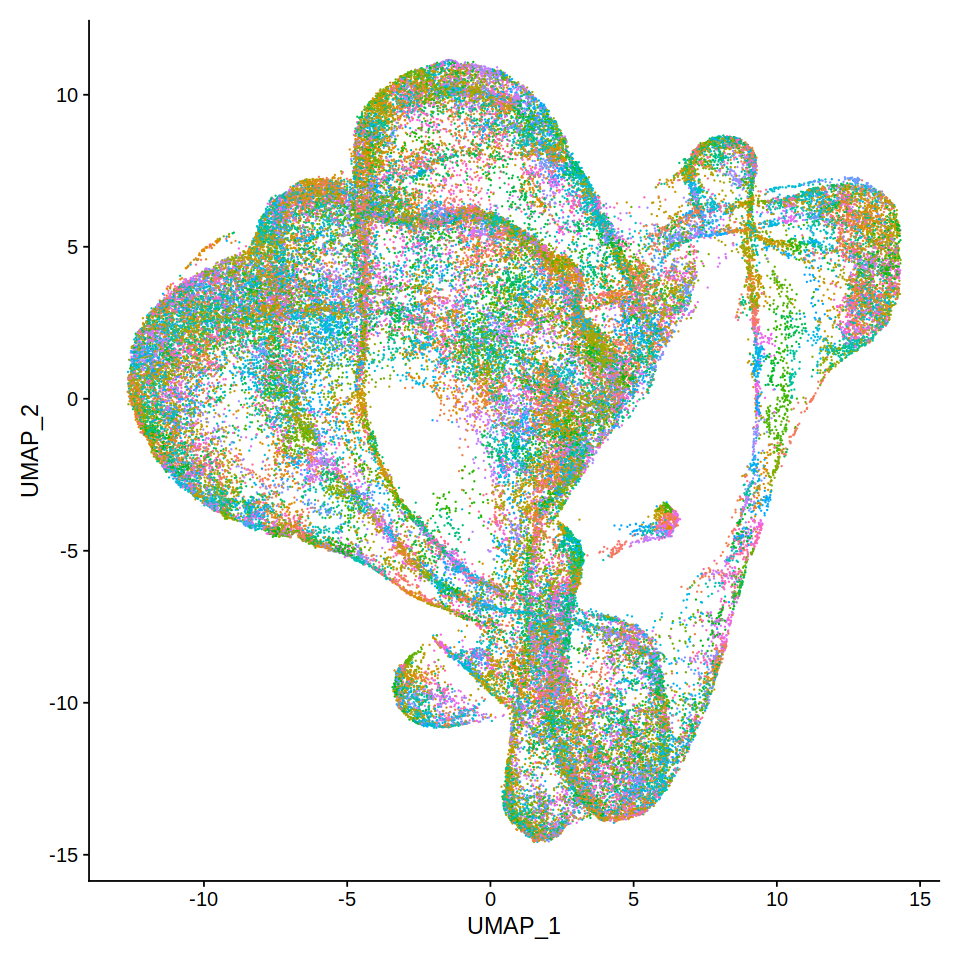

In [58]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap")+NoLegend()

In [59]:
anno <- rc.integrated$seurat_clusters
for (i in unique(rc.integrated$seurat_clusters)){
    if (max(apply(msc[which(rc.integrated$seurat_clusters==i),],2,mean))>0){
        ct <- names(which.max(apply(msc[which(rc.integrated$seurat_clusters==i),],2,mean)))
    } else {
        ct <- "NA"
    }
        anno <- gsub(paste0("^",i,"$"), ct, anno, ignore.case = FALSE, perl = FALSE,fixed = FALSE, useBytes = FALSE)
}

In [60]:
rc.integrated$score.anno <- anno

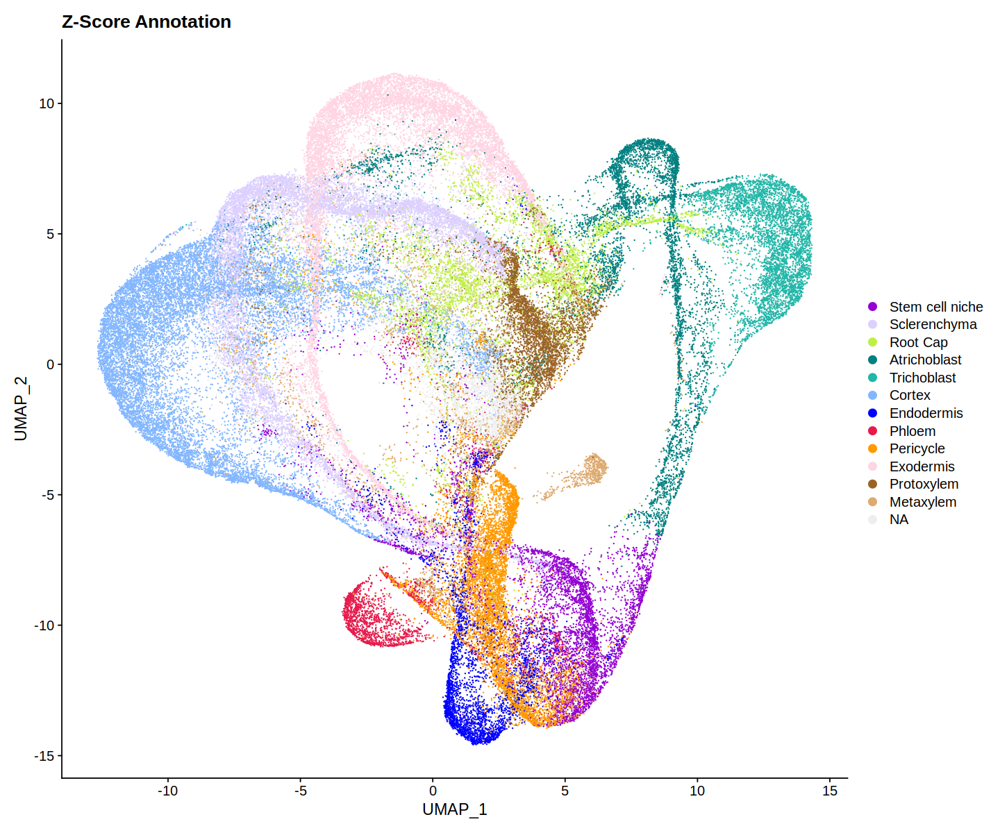

In [61]:
# Plot marker annotation
order <- c("Stem cell niche", "Sclerenchyma", "Columella", "Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Vascular Tissue","Pericycle","Exodermis","Epidermis", "Protoxylem", "Metaxylem", "NA")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#dd77ec", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$score.anno <- factor(rc.integrated$score.anno , levels = order[sort(match(unique(rc.integrated$score.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$score.anno),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "score.anno", cols = color)+ggtitle("Z-Score Annotation")

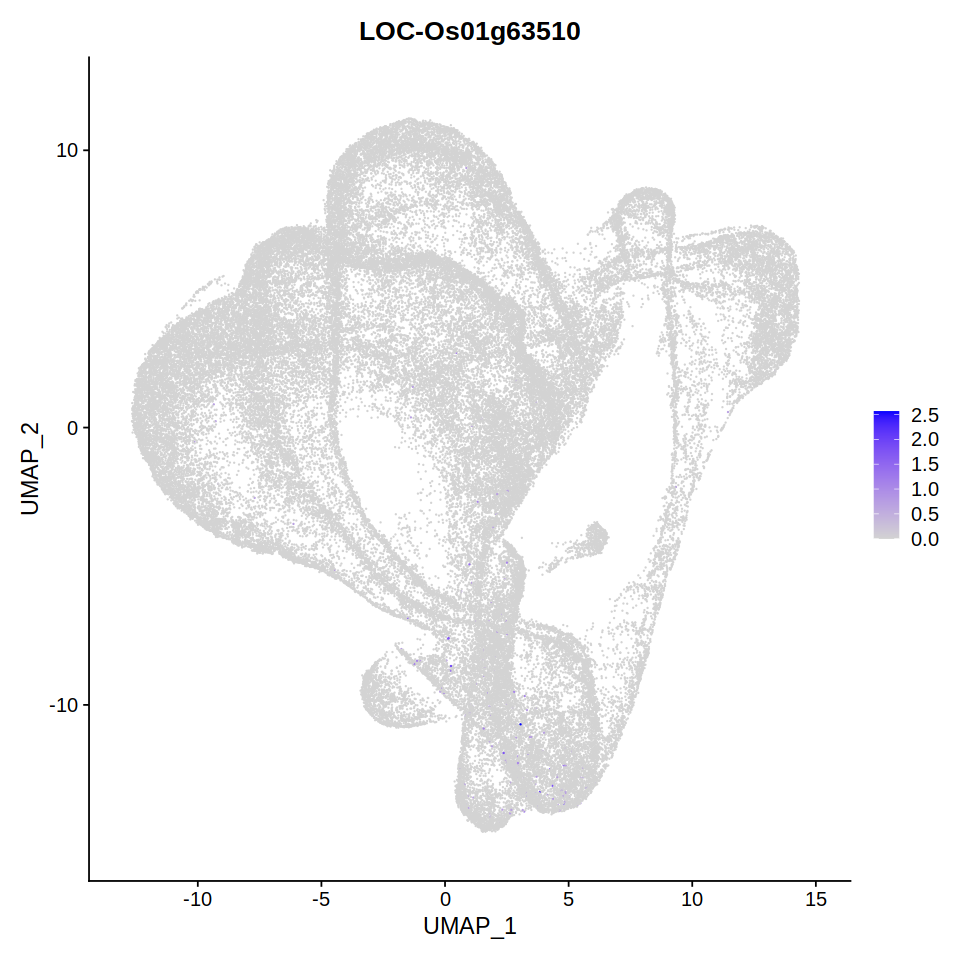

In [62]:
## QC marker
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os01g63510")

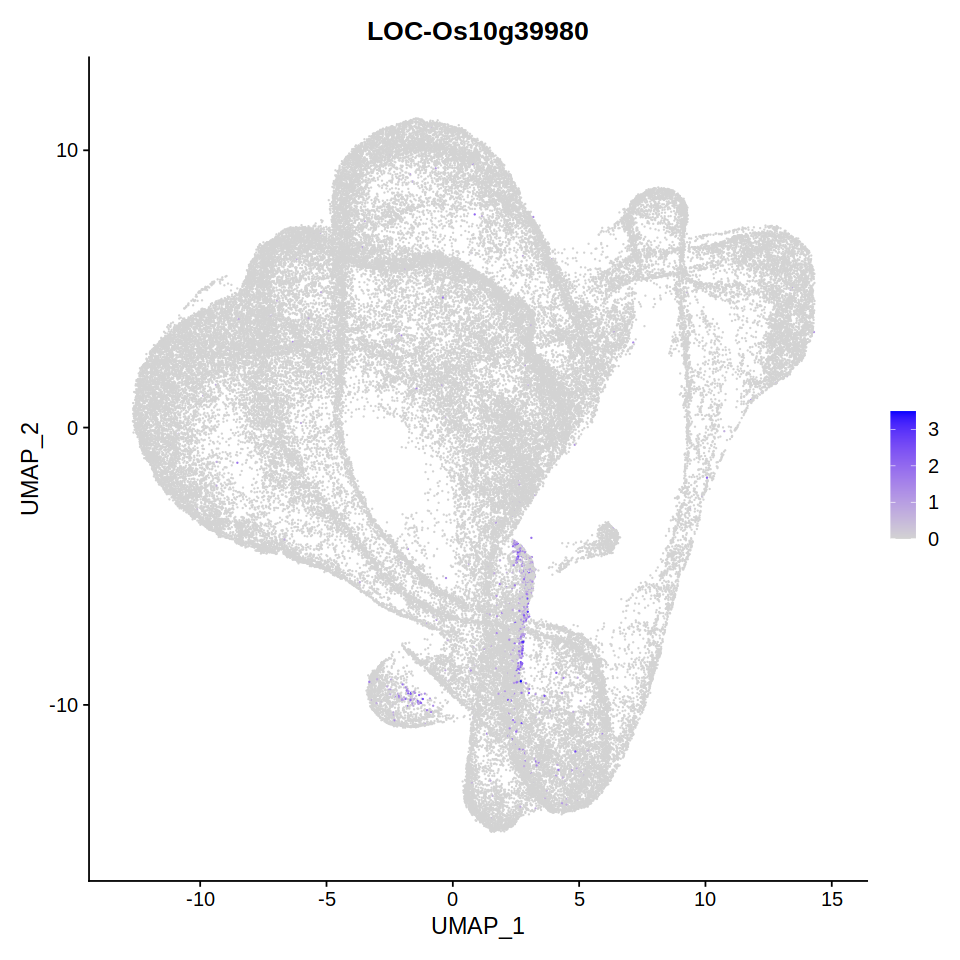

In [63]:
## Pericycle marker
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os10g39980")

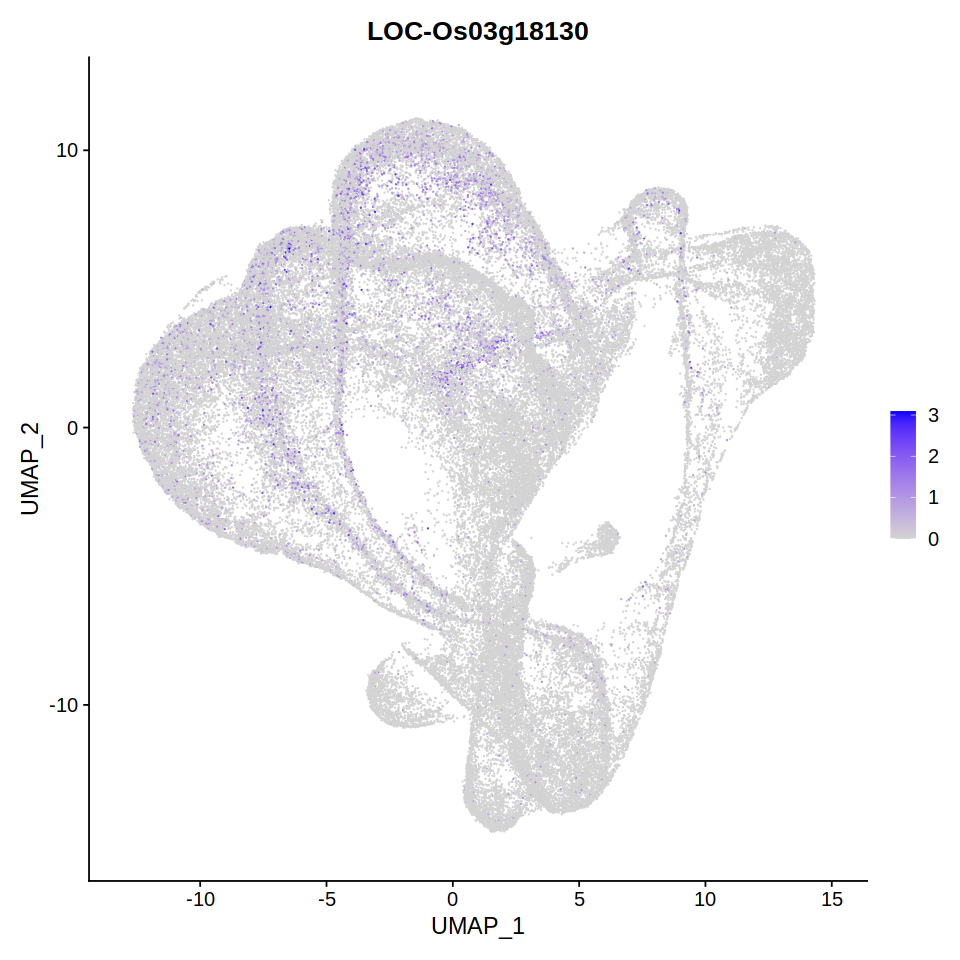

In [64]:
## New Root Cap Marker
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os03g18130")

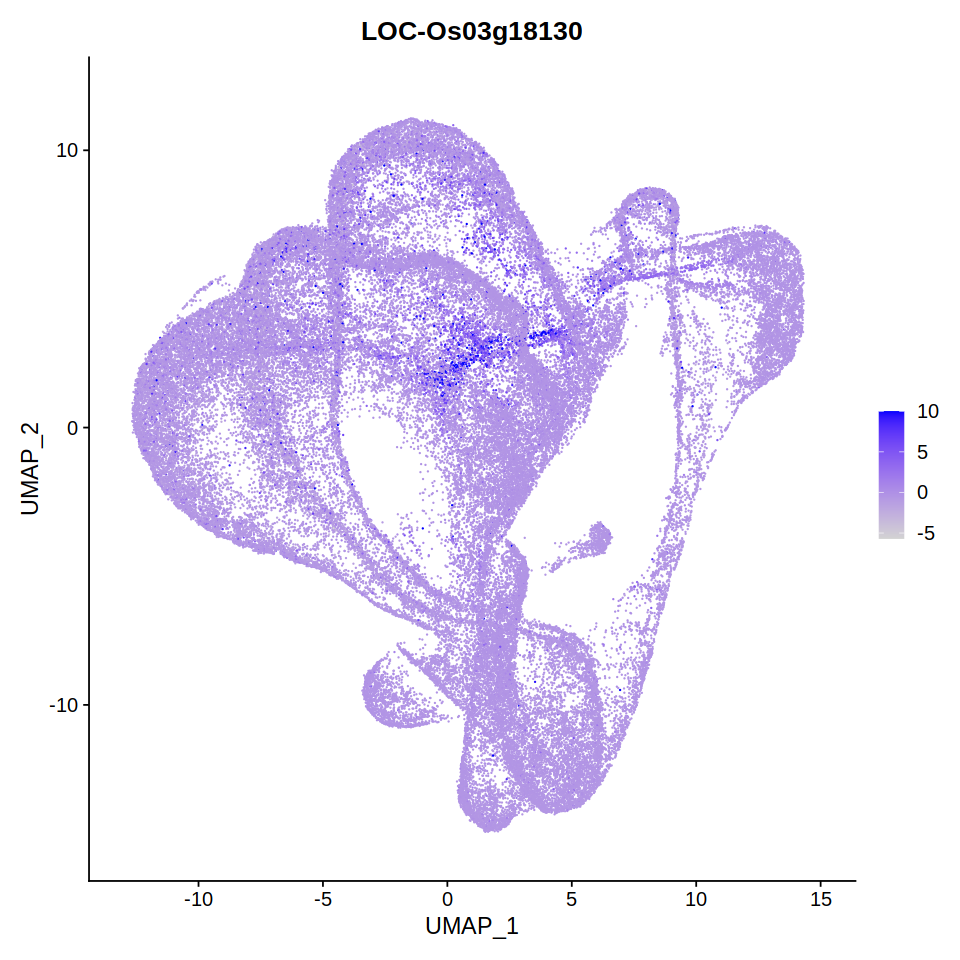

In [65]:
## New Root Cap Marker 
DefaultAssay(rc.integrated) <- "integrated"
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os03g18130")

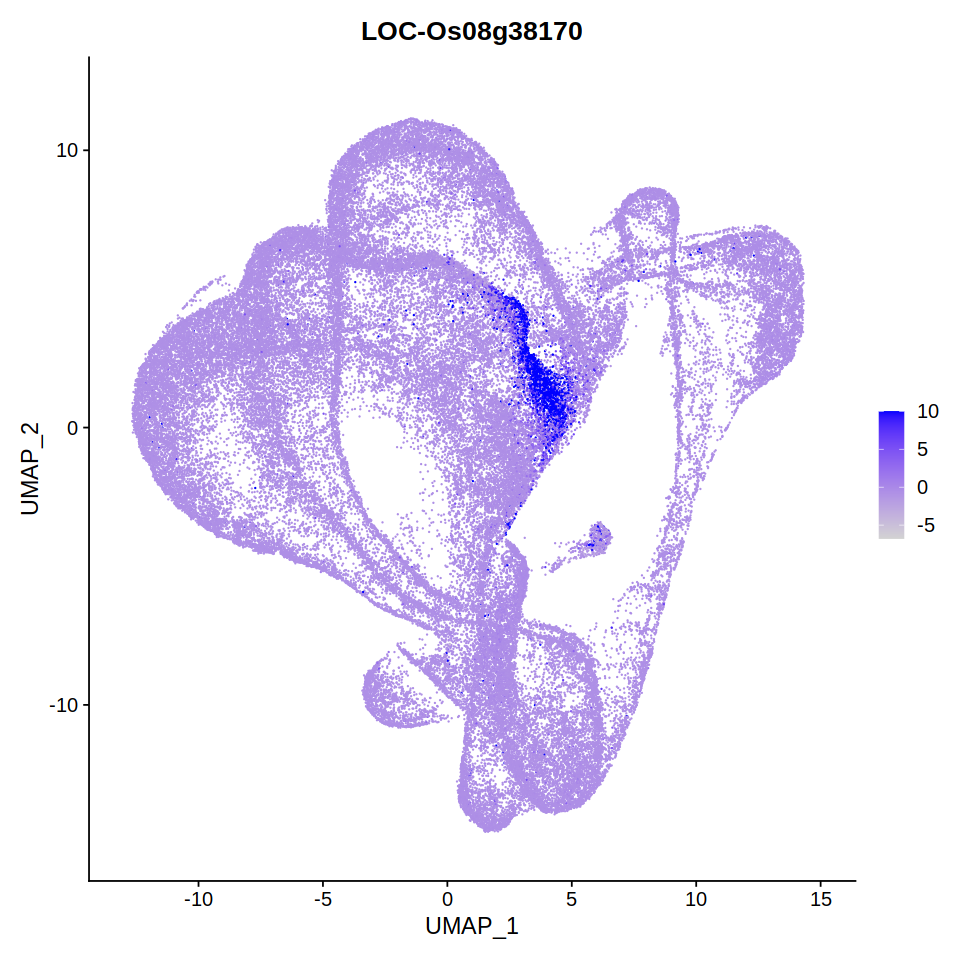

In [66]:
## Xylem markers (Marker from Zhang et al.)
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os08g38170")

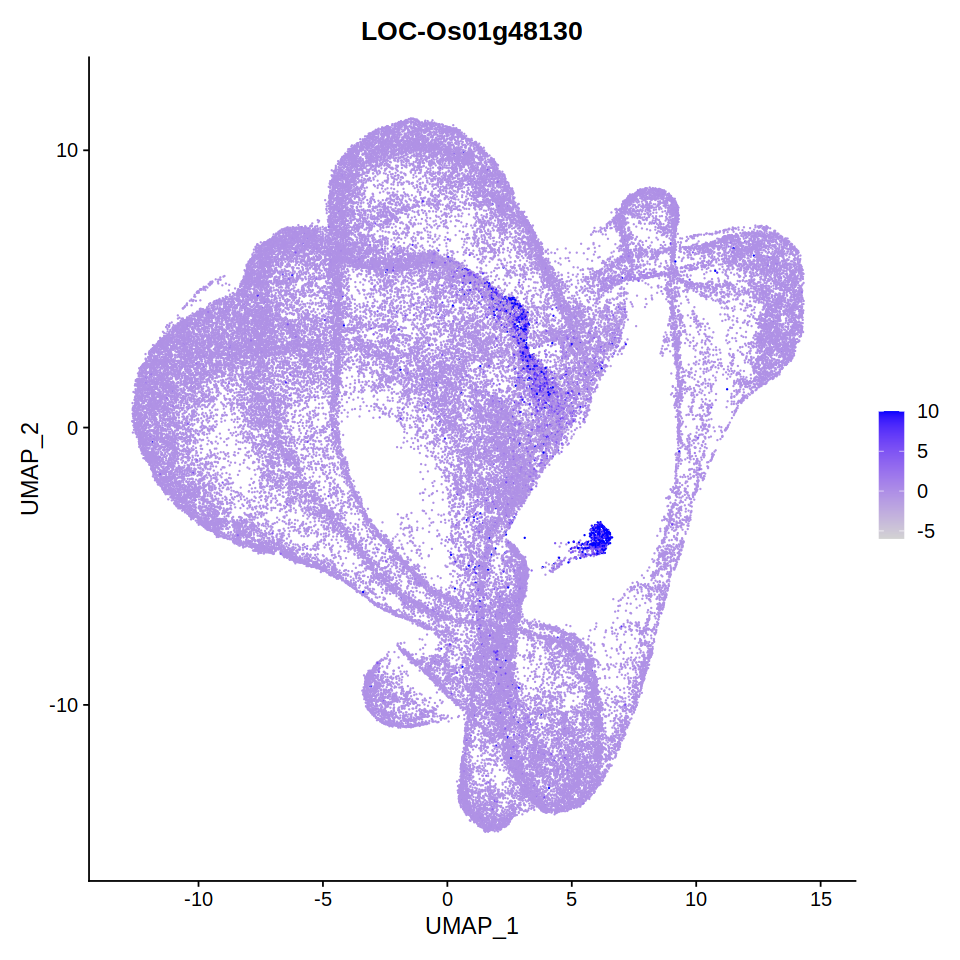

In [67]:
## Xylem markers (Marker from Benfey lab)
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os01g48130")

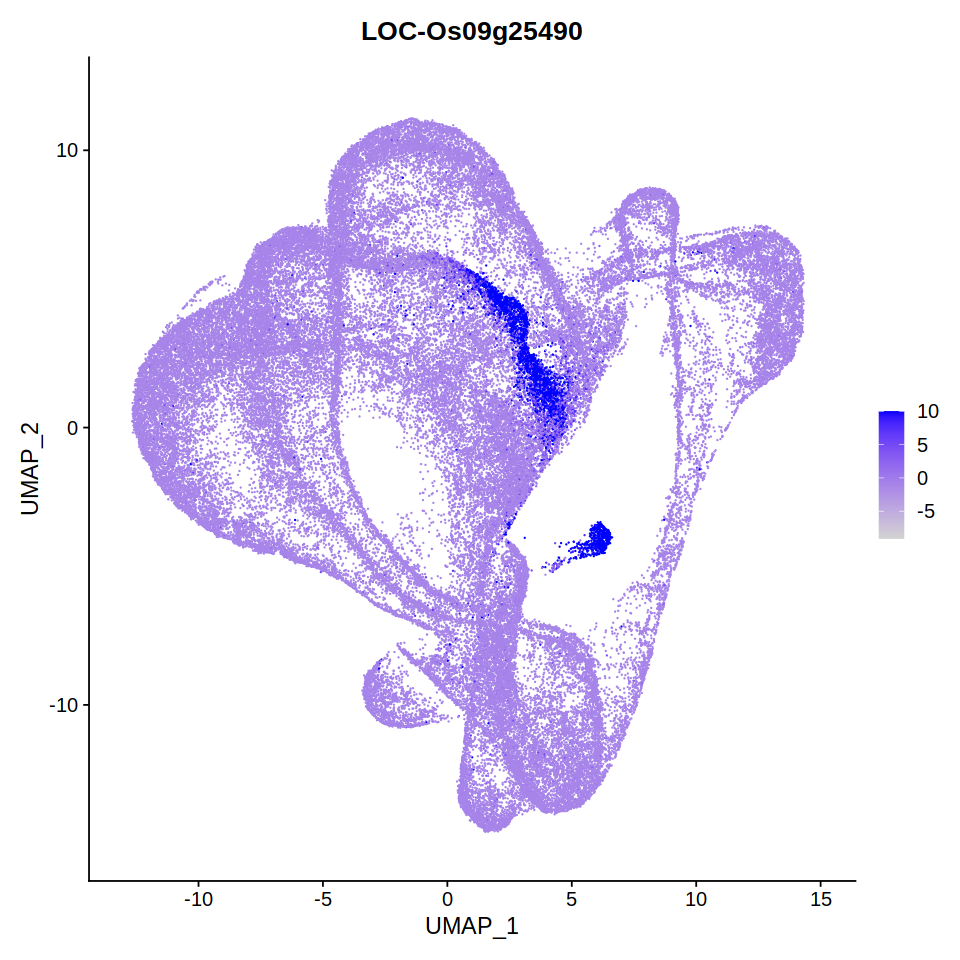

In [68]:
## Xylem markers (Marker from Benfey lab)
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os09g25490")

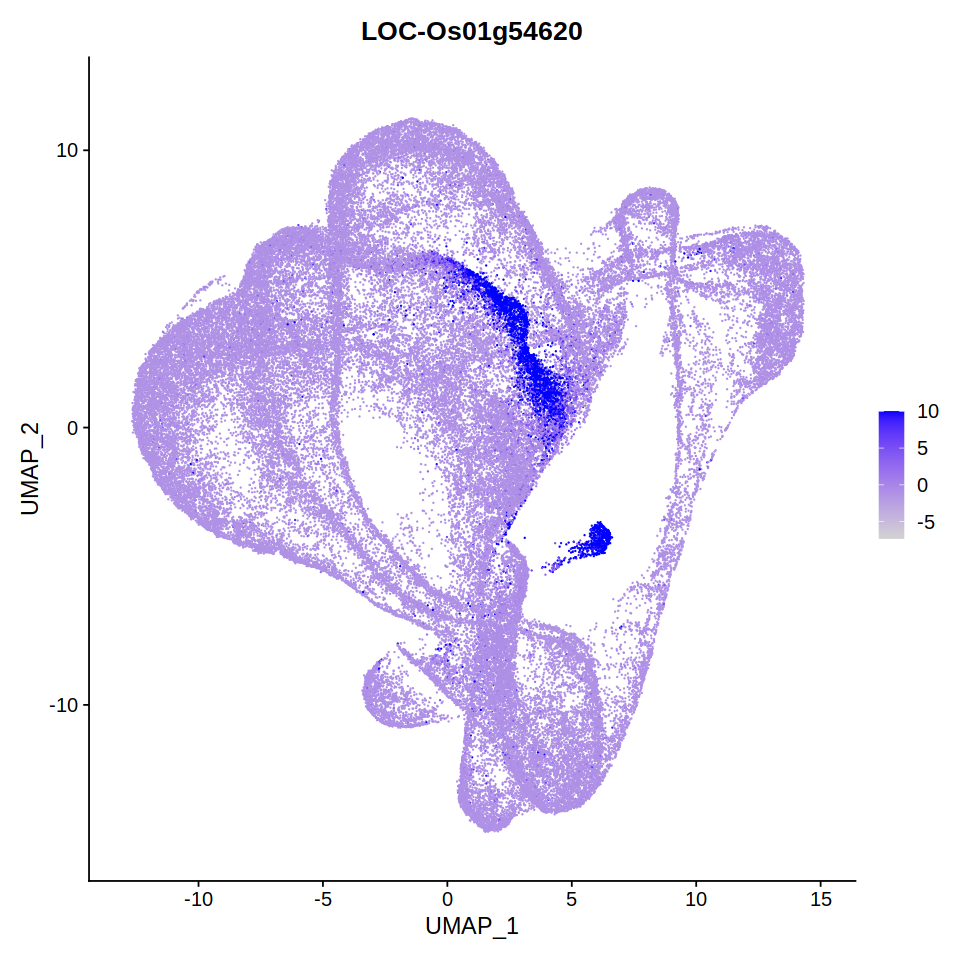

In [69]:
## Xylem markers (Marker from Benfey lab)
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os01g54620")

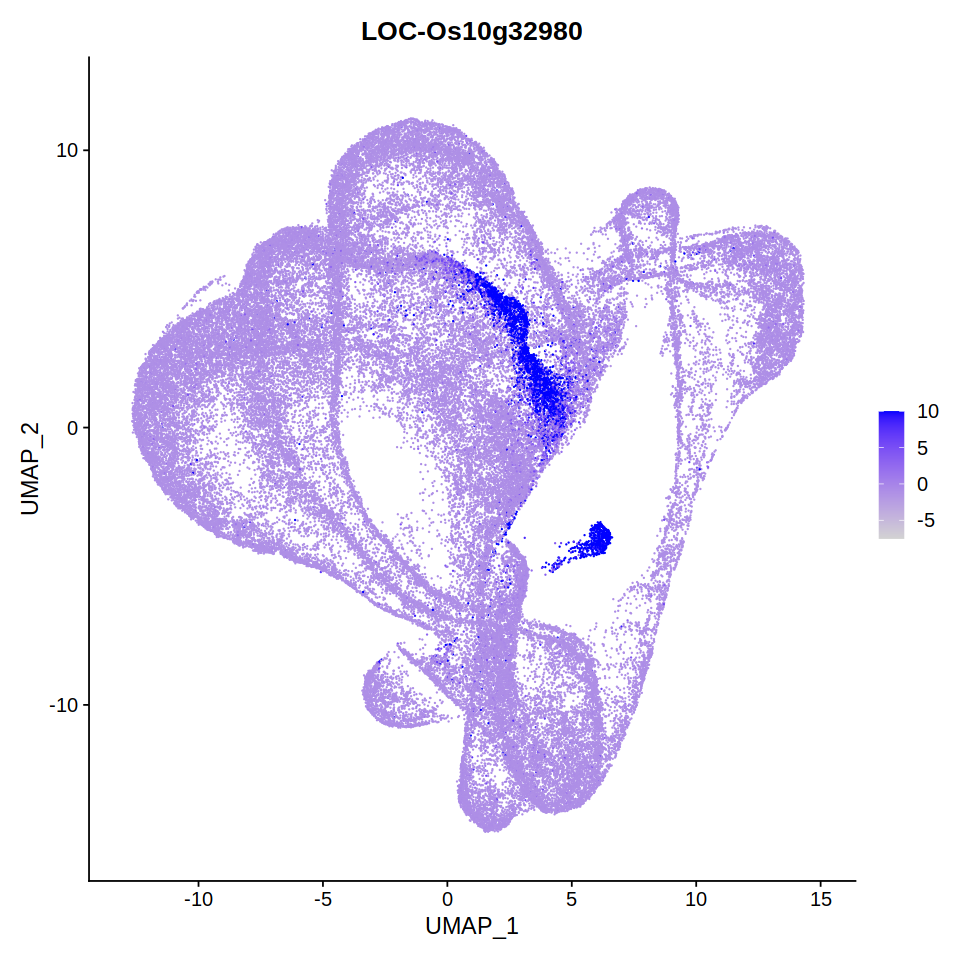

In [70]:
## Xylem markers (Marker from Benfey lab)
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os10g32980")

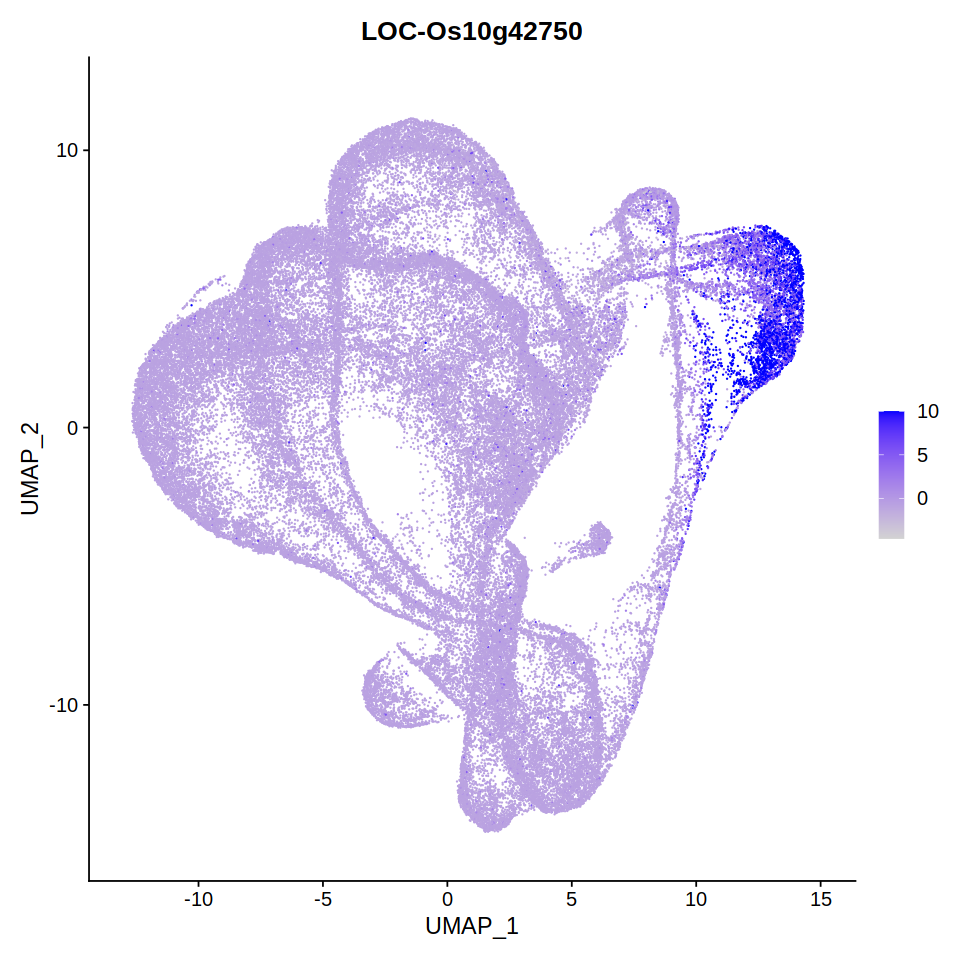

In [71]:
## New trichoblast markers (Marker from Zhang)
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os10g42750")

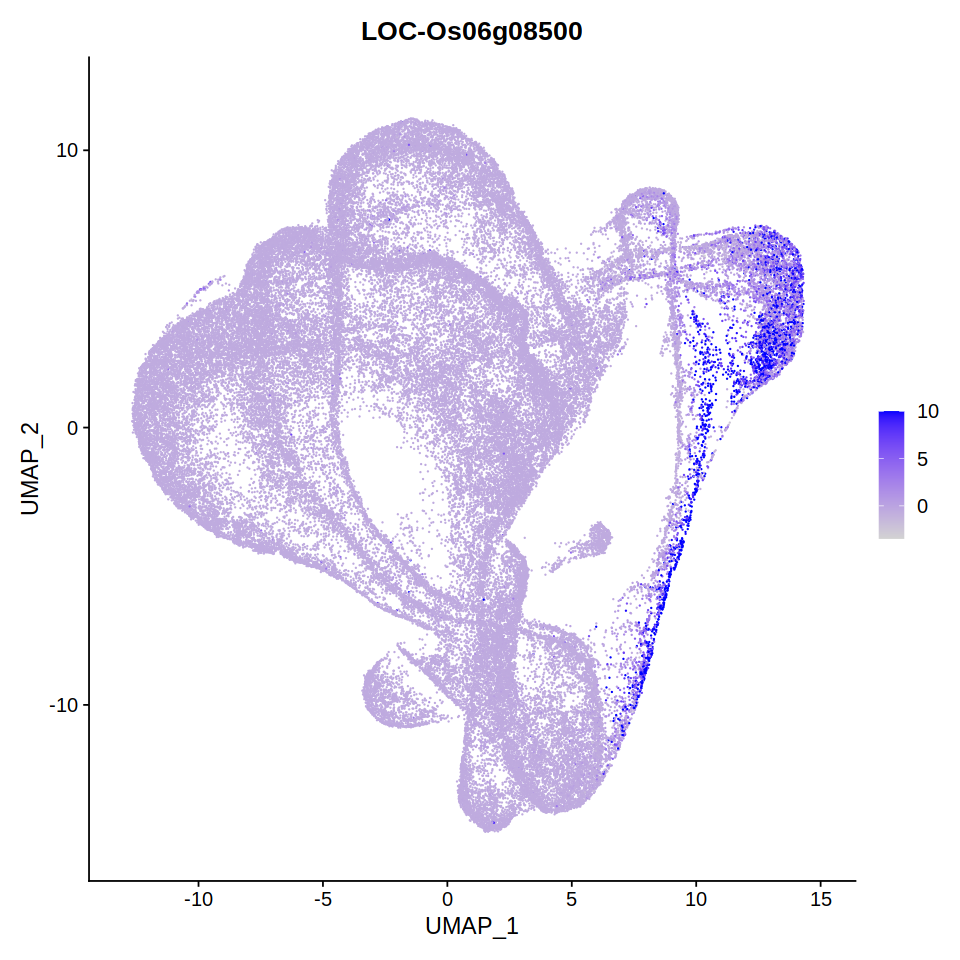

In [72]:
## New trichoblast markers (Marker from Ding)
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os06g08500")

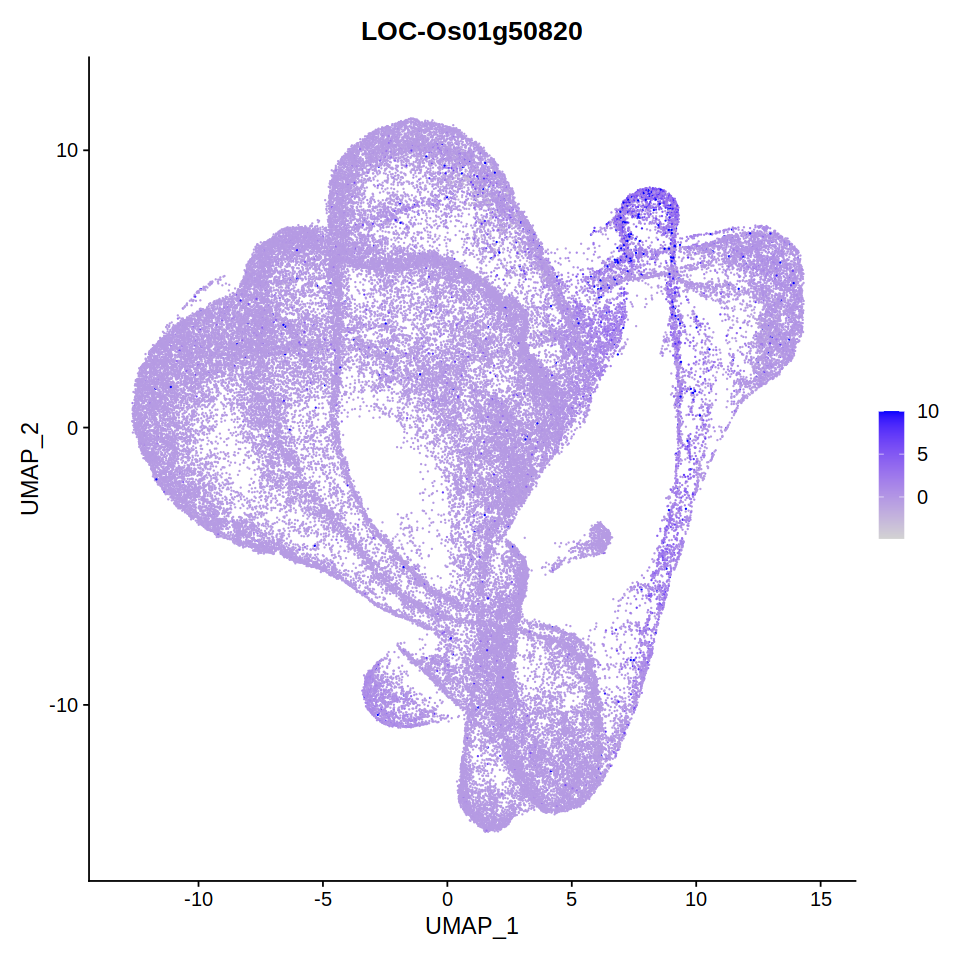

In [73]:
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os01g50820")

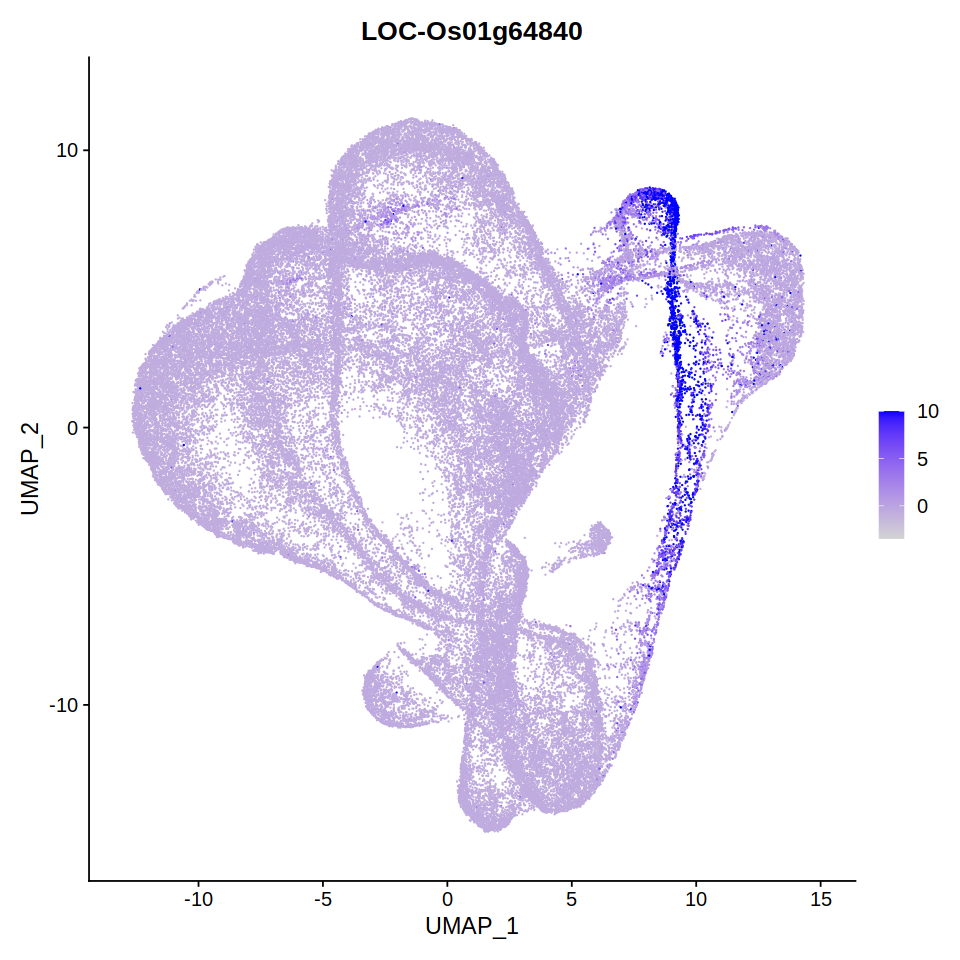

In [74]:
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os01g64840")

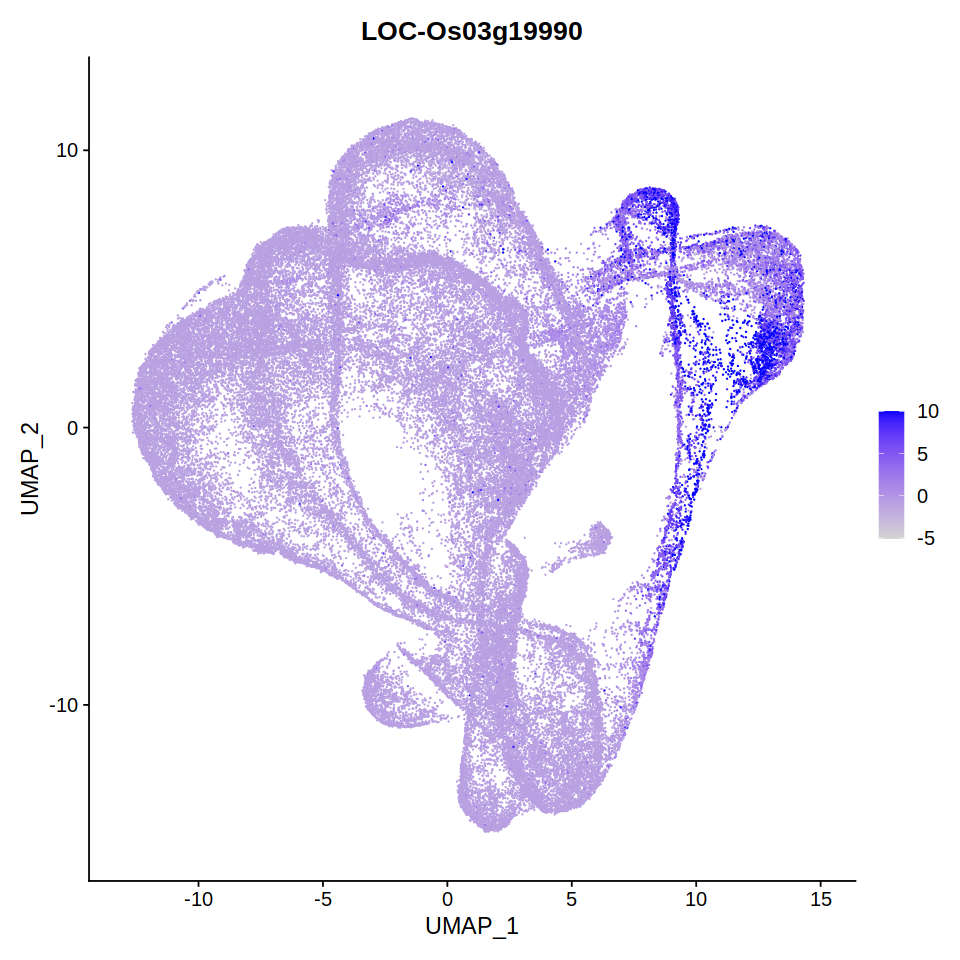

In [75]:
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os03g19990")

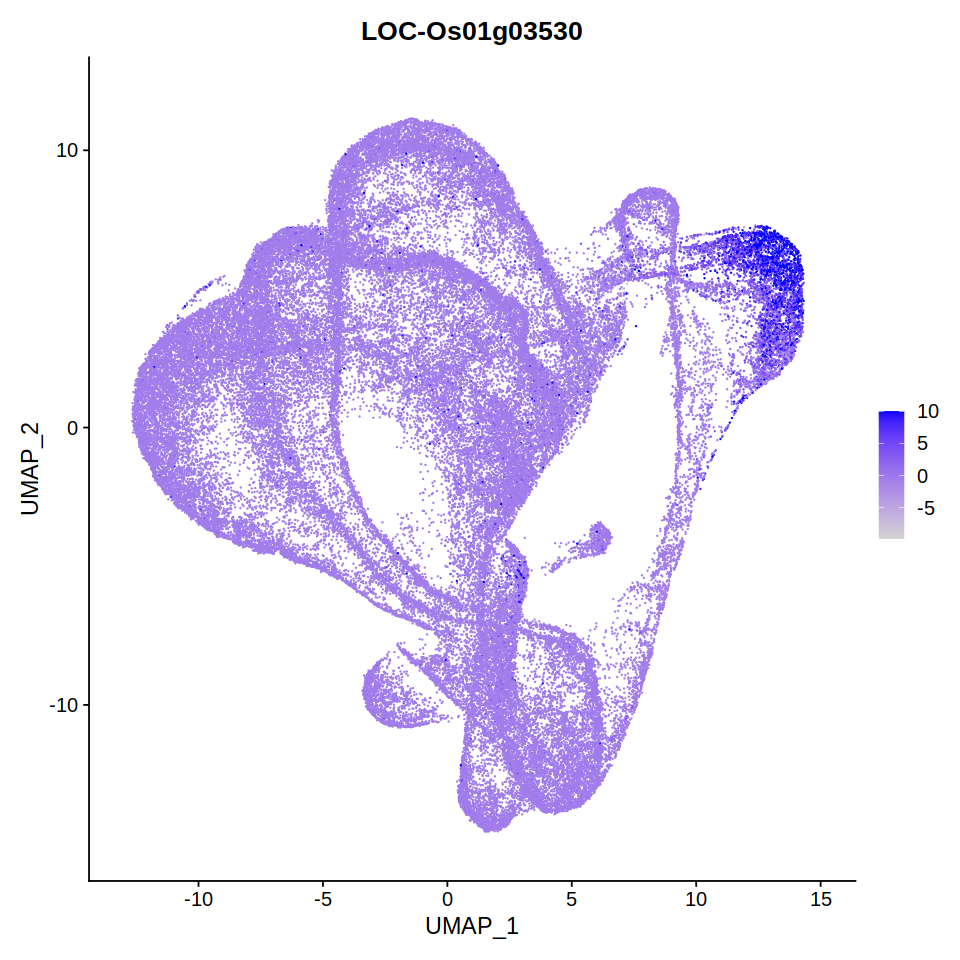

In [76]:
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os01g03530")

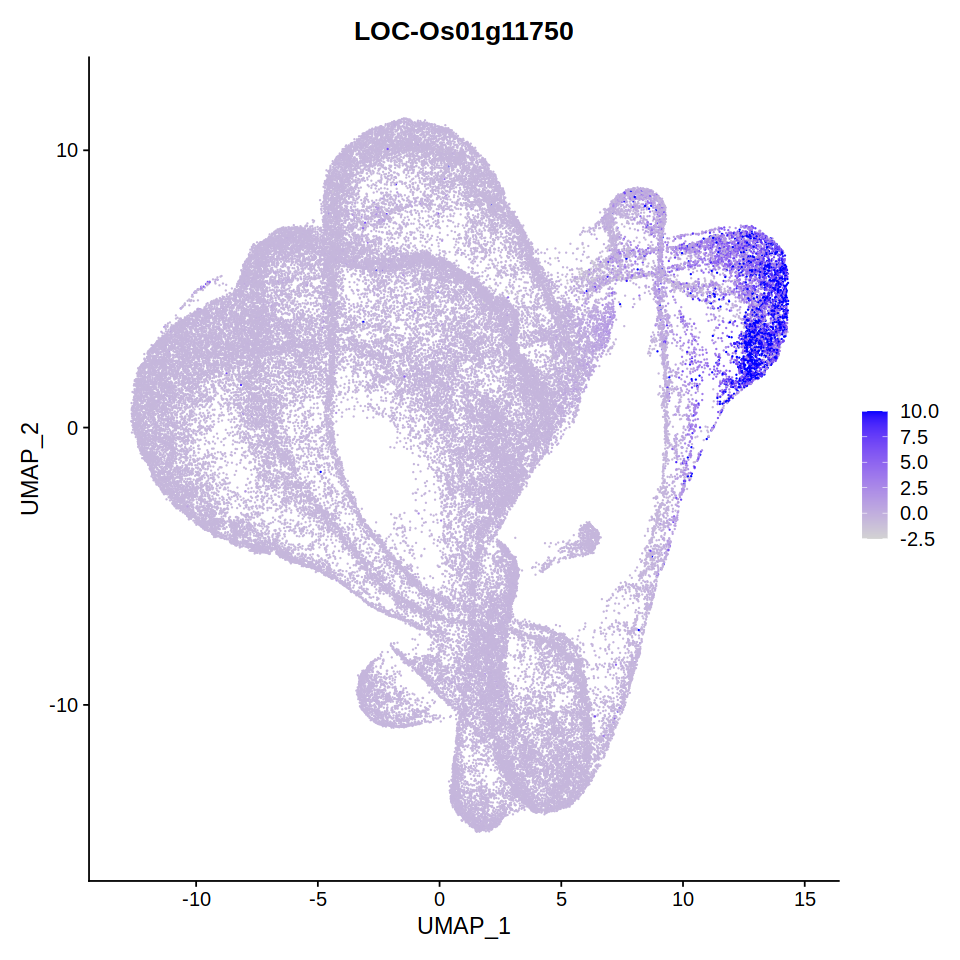

In [77]:
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os01g11750")

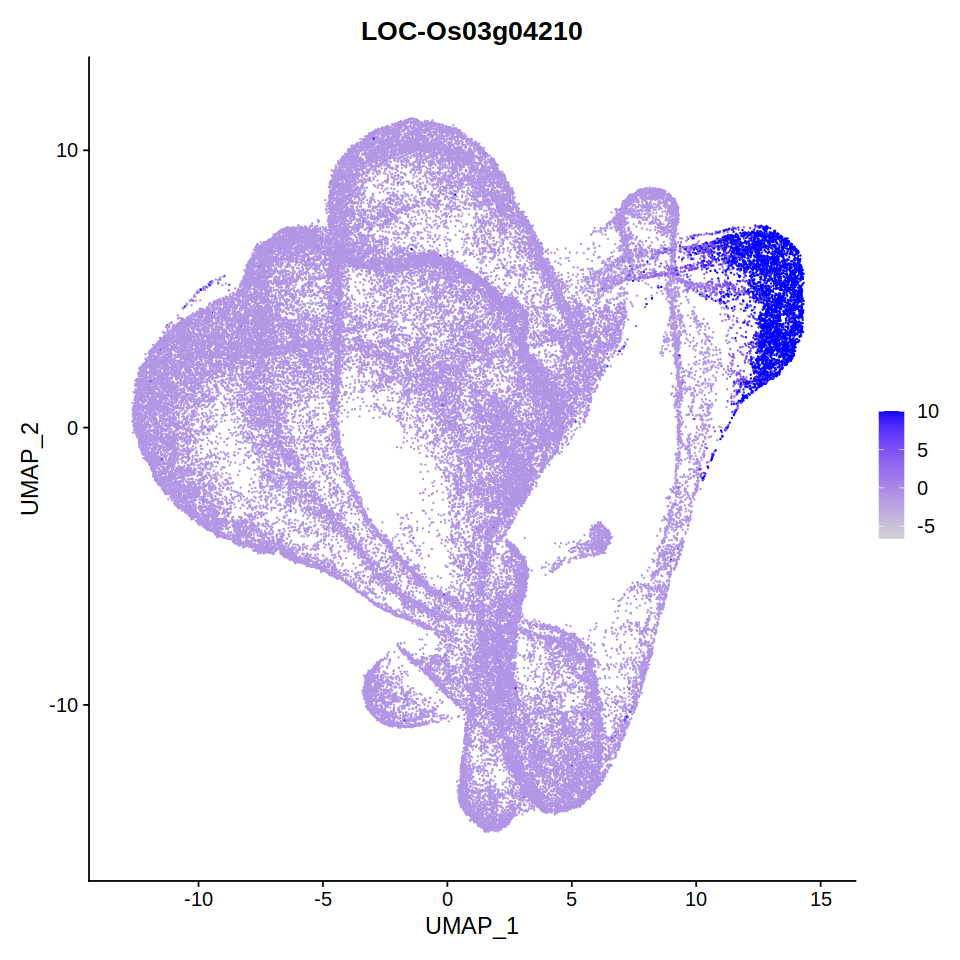

In [78]:
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os03g04210")

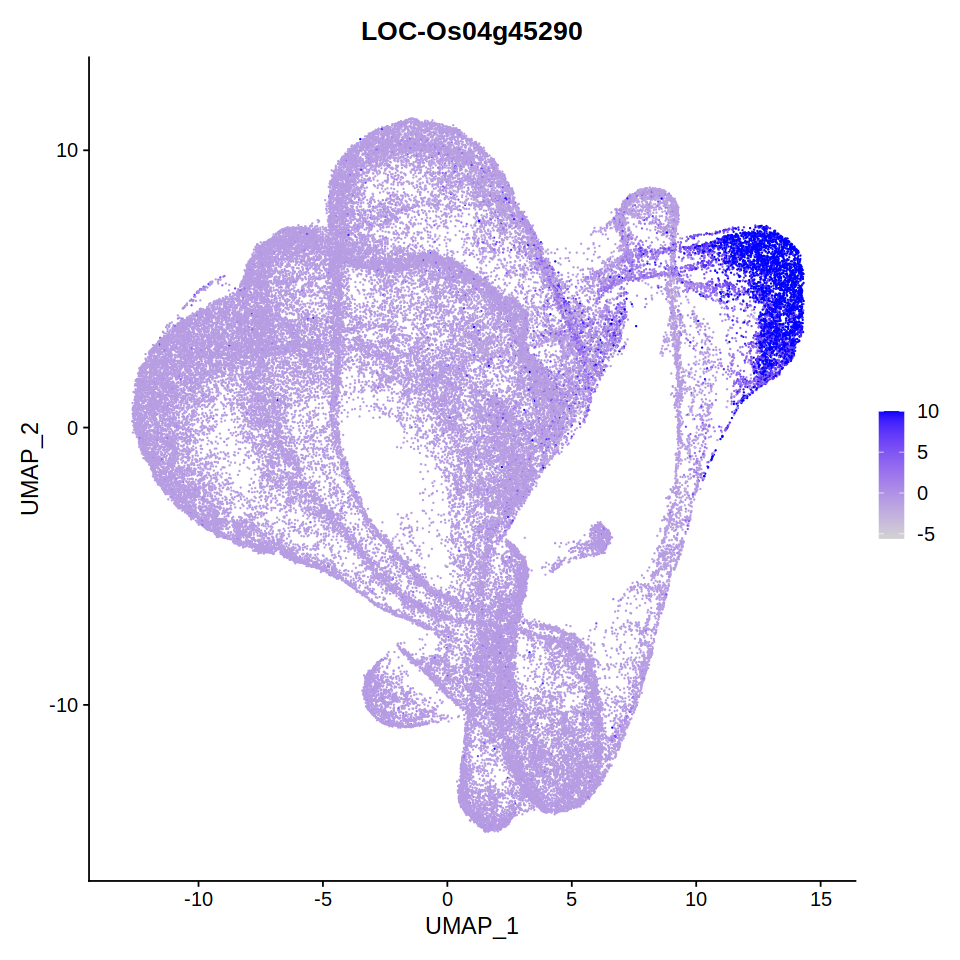

In [79]:
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os04g45290")

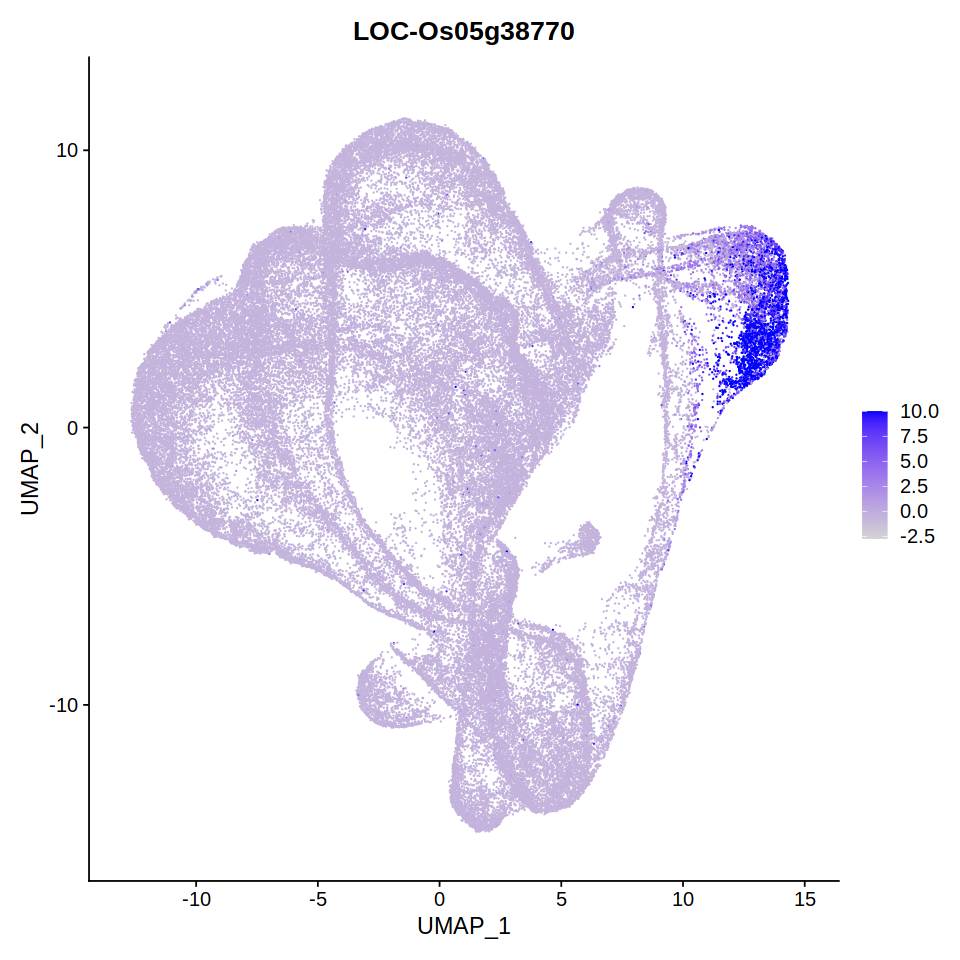

In [80]:
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os05g38770")

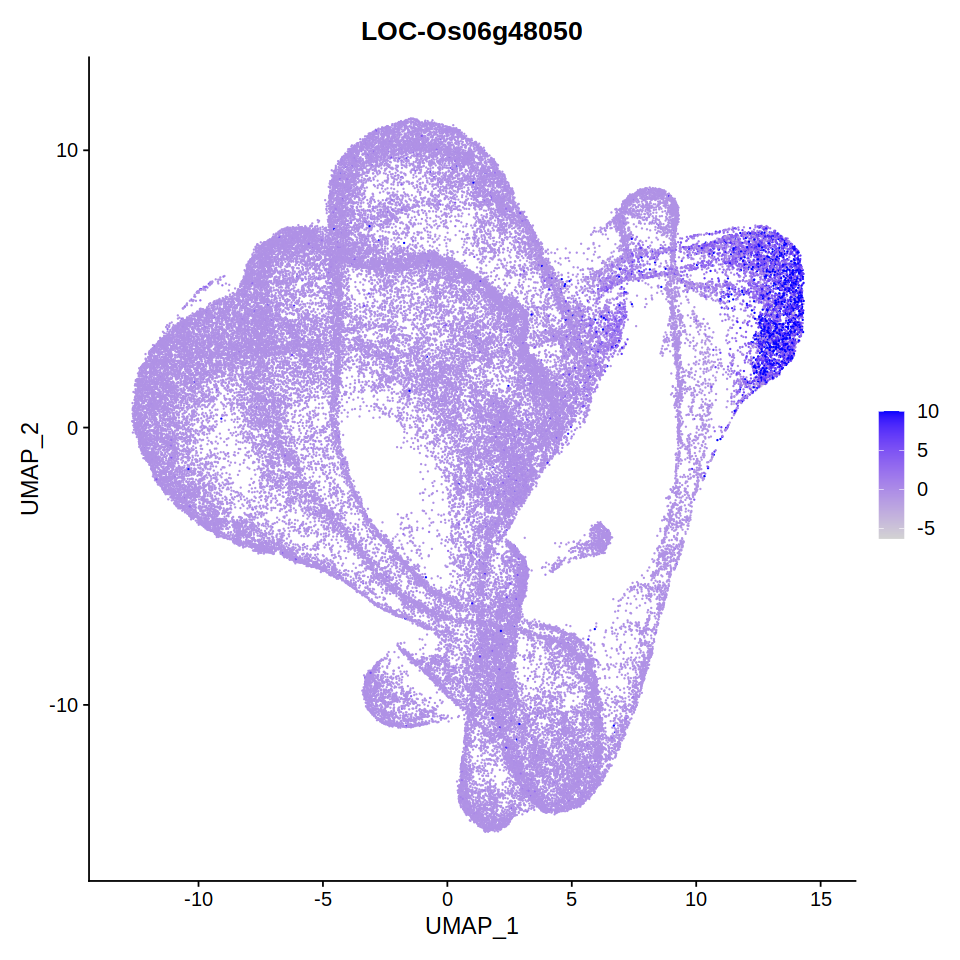

In [81]:
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os06g48050")

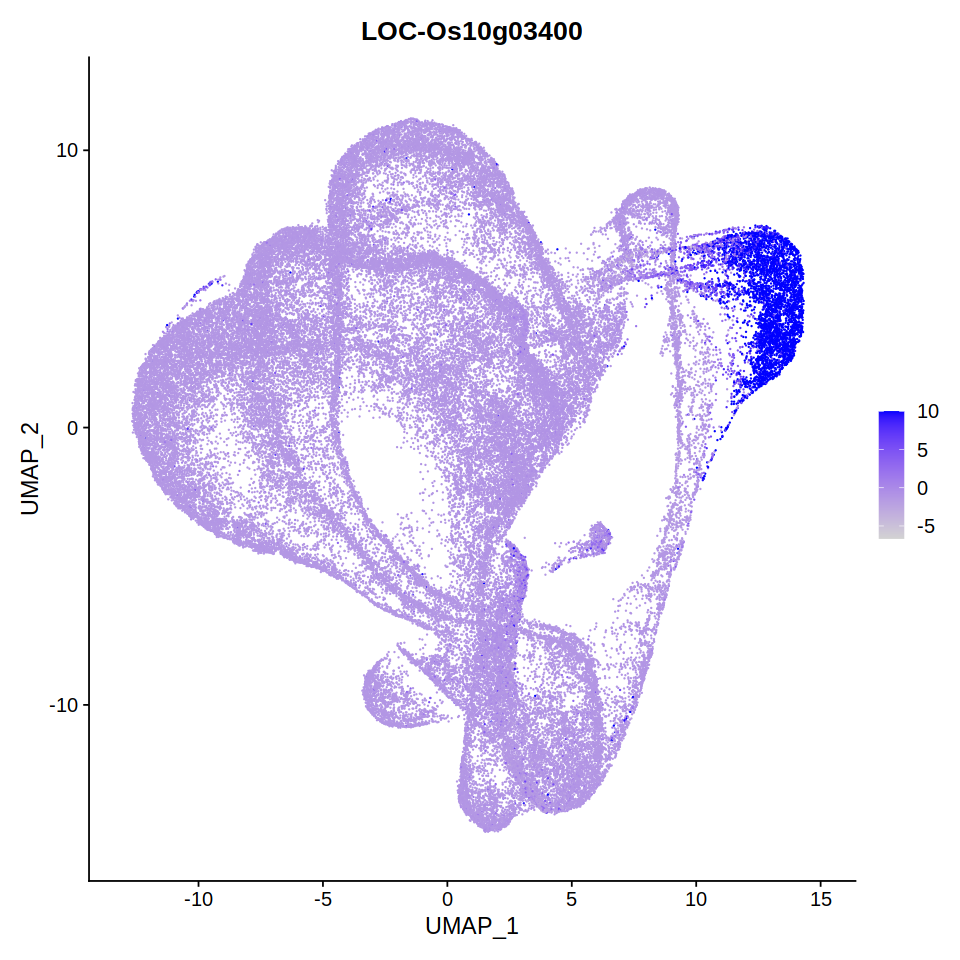

In [82]:
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os10g03400")

In [83]:
## Root Cap juctions
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, feature= "LOC-Os10g31660")

Warning message:
“Found the following features in more than one assay, excluding the default. We will not include these in the final dataframe: LOC-Os10g31660”
Warning message in FetchData(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: LOC-Os10g31660”


ERROR: Error: None of the requested features were found: LOC-Os10g31660 in slot data


## Consensus Annotation

In [87]:
dat <- data.frame(rc.integrated$score.anno, rc.integrated$score.crude.anno, rc.integrated$timezone.ID.P)

In [88]:
rc.integrated$consensus.anno <- apply(dat,1,function(x){if(x[1]=="NA" & x[2]=="NA"){"Unknown"}else if(x[1]==x[2]){x[1]}else if(x[1]=="Trichoblast" & x[2]=="Atrichoblast"){"Trichoblast"}else if(x[1]=="Vascular Tissue" & x[2]=="NA"){"Vascular Tissue"}
    else if(x[1]=="Metaxylem" & x[2]=="Phloem"){"Metaxylem"}else if(x[1]=="Cortex" & x[2]=="Sclerenchyma"){"Cortex"}
        else if(x[1]=="Exodermis" & x[2]=="Sclerenchyma"){"Exodermis"}else if(x[1]=="Exodermis" & x[2]=="Endodermis"){"Exodermis"}
            else if(x[1]=="Cortex" & x[2]=="Endodermis"){"Cortex"}else if(x[1]=="Pericycle" & x[2]=="Endodermis"){"Pericycle"}else if(x[1]=="Phloem" & x[2]=="Endodermis"){"Phloem"}
                    else if(x[1]=="Metaxylem" & x[2]=="Endodermis"){"Metaxylem"}else if (x[1]=="NA"|x[2]=="NA"){"Unknown"}else if(x[3]=="Maturation1"|x[3]=="Maturation2"){x[2]}else {"Unknown"}}) 

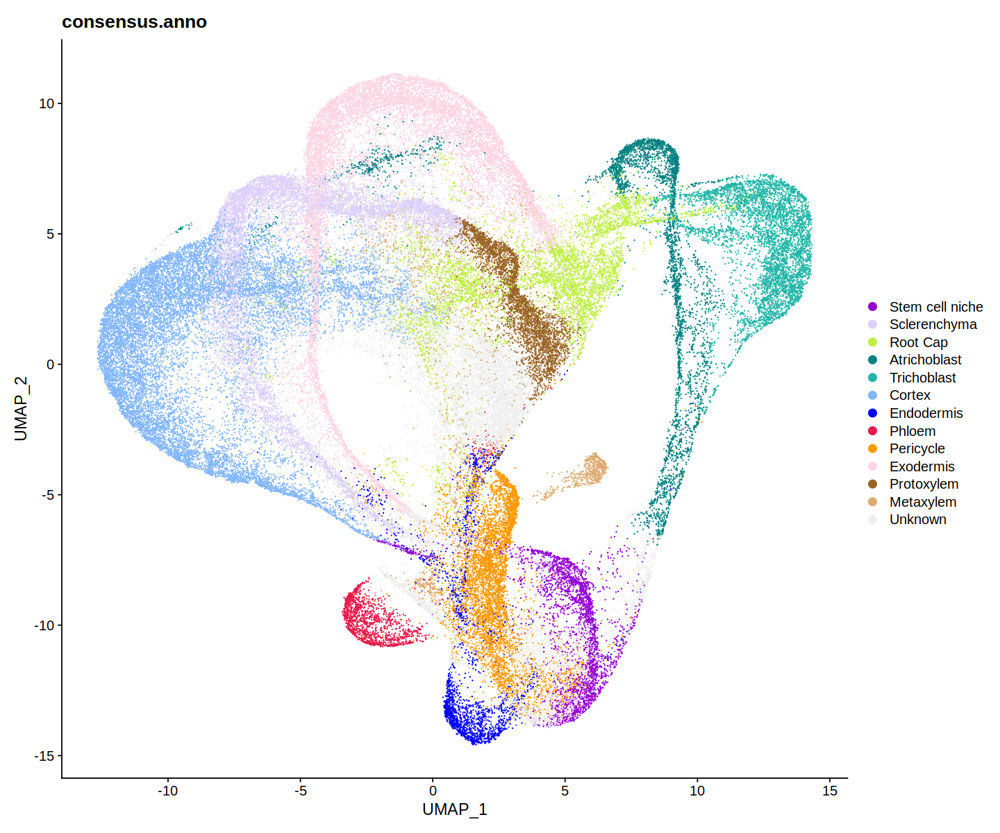

In [89]:
order <- c("Stem cell niche", "Sclerenchyma", "Columella", "Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Vascular Tissue","Pericycle","Exodermis","Epidermis", "Protoxylem", "Metaxylem", "Unknown")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#dd77ec", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$consensus.anno <- factor(rc.integrated$consensus.anno , levels = order[sort(match(unique(rc.integrated$consensus.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$consensus.anno),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "consensus.anno", cols = color)+ggtitle("consensus.anno")

## Correlation annotation round1

In [90]:
rc.integrated$new_ref <- paste0(gsub("Maturation.$","Maturation",rc.integrated$timezone.ID.P), "_",rc.integrated$consensus.anno)

In [91]:
table(rc.integrated$new_ref)


   Elongation_Atrichoblast          Elongation_Cortex 
                      1091                       8944 
     Elongation_Endodermis       Elongation_Exodermis 
                        43                       4218 
      Elongation_Metaxylem       Elongation_Pericycle 
                       104                          9 
         Elongation_Phloem        Elongation_Root Cap 
                        44                         20 
   Elongation_Sclerenchyma     Elongation_Trichoblast 
                      4716                         80 
        Elongation_Unknown    Maturation_Atrichoblast 
                      1275                       1467 
         Maturation_Cortex      Maturation_Endodermis 
                      1183                        302 
      Maturation_Exodermis       Maturation_Metaxylem 
                      4792                       1545 
      Maturation_Pericycle          Maturation_Phloem 
                      1186                        338 
     Matu

In [92]:
rc.integrated$new_ref <- gsub(".*Unknown$","Unknown",rc.integrated$new_ref)
rc.integrated$new_ref <- gsub(".*Root Cap$","Root Cap",rc.integrated$new_ref)
rc.integrated$new_ref <- gsub("Elongation_Stem cell niche","Unknown",rc.integrated$new_ref)
rc.integrated$new_ref <- gsub("Maturation_Stem cell niche","Unknown",rc.integrated$new_ref)
rc.integrated$new_ref <- gsub("^Meristem.*","Meristem",rc.integrated$new_ref)

In [93]:
table(rc.integrated$new_ref)


Elongation_Atrichoblast       Elongation_Cortex   Elongation_Endodermis 
                   1091                    8944                      43 
   Elongation_Exodermis    Elongation_Metaxylem    Elongation_Pericycle 
                   4218                     104                       9 
      Elongation_Phloem Elongation_Sclerenchyma  Elongation_Trichoblast 
                     44                    4716                      80 
Maturation_Atrichoblast       Maturation_Cortex   Maturation_Endodermis 
                   1467                    1183                     302 
   Maturation_Exodermis    Maturation_Metaxylem    Maturation_Pericycle 
                   4792                    1545                    1186 
      Maturation_Phloem   Maturation_Protoxylem Maturation_Sclerenchyma 
                    338                    3669                    1882 
 Maturation_Trichoblast                Meristem                Root Cap 
                   5007                   19667   

In [94]:
length(sort(table(rc.integrated$new_ref[which(rc.integrated$new_ref!="Unknown")])))

[1] 21

In [95]:
nnc <- length(sort(table(rc.integrated$new_ref[which(rc.integrated$new_ref!="Unknown")]))) 
# Extract integrated (batch-corrected) expression matrix
afm <- rc.integrated@assays$integrated@data

# Pool (average) expression values of each grouping
new_ref <- matrix(nrow=nrow(afm), ncol = 0)
for (i in 1:nnc) {
m <- afm[,which(rc.integrated$new_ref==as.character(unique(rc.integrated$new_ref[which(rc.integrated$new_ref!="Unknown")]))[i])]
new_ref <- cbind(new_ref, rowSums(m)/ncol(m))
}
colnames(new_ref) <- as.character(unique(rc.integrated$new_ref[which(rc.integrated$new_ref!="Unknown")]))
gene.var <- apply(new_ref,1,var)

# Select top 200 highly variable genes 
new_ref_sub <- new_ref[names(sort(gene.var,decreasing = TRUE)[1:200]),]

# Merge newly-built reference with atlas

merge.rownames <- function (x,y){
  dat <- merge(x = x, y = y, by = "row.names")
  rownames(dat) <- dat$Row.names
  dat <- dat[,-1]
  return(dat)
}

nr <- Reduce(merge.rownames, list(new_ref_sub,afm)) 
nr <- as.matrix(nr)

In [96]:
colnames(nr)[1:nnc+1]

[1] "Elongation_Sclerenchyma" "Maturation_Exodermis"   
 [3] "Elongation_Exodermis"    "Maturation_Trichoblast" 
 [5] "Elongation_Cortex"       "Maturation_Protoxylem"  
 [7] "Root Cap"                "Maturation_Atrichoblast"
 [9] "Maturation_Phloem"       "Maturation_Sclerenchyma"
[11] "Elongation_Atrichoblast" "Elongation_Metaxylem"   
[13] "Maturation_Endodermis"   "Maturation_Metaxylem"   
[15] "Maturation_Cortex"       "Maturation_Pericycle"   
[17] "Elongation_Endodermis"   "Elongation_Trichoblast" 
[19] "Elongation_Phloem"       "Elongation_Pericycle"   
[21] "AAACCCAAGAATACAC_1"

In [97]:
# Correlation-based annotation using newly-built references
nr_label=colnames(new_ref)
nr_stat <- suppressWarnings(sapply((nnc+1):ncol(nr), function(i) sapply(1:nnc, function(j) cor.test(nr[,i],nr[,j],method = "pearson")[c(3,4)])))
nr_cor <- nr_stat[seq(2,nrow(nr_stat),2),]
nr_pvalue <- nr_stat[seq(1,nrow(nr_stat)-1,2),]                                                                                                        
nr_max <- sapply(1:(ncol(nr)-nnc), function(i) max(as.numeric(nr_cor[,i])))
nr_ident <- sapply(1:(ncol(nr)-nnc), function(i) nr_label[which(as.numeric(nr_cor[,i])==max(as.numeric(nr_cor[,i])))])
nr_maxp <- sapply(1:(ncol(nr)-nnc), function(i) as.numeric(nr_pvalue[,i])[which(as.numeric(nr_cor[,i])==max(as.numeric(nr_cor[,i])))])                     
names(nr_max) <- nr_ident
rc.integrated$final.anno.P <- as.character(nr_ident)
rc.integrated$final.anno.cor.P <- as.numeric(nr_max)
rc.integrated$final.anno.pvalue.P <- as.numeric(nr_maxp)

In [98]:
rc.integrated$celltype.anno <-  gsub("^Meristem_","",gsub("^Elongation_","",gsub("^Maturation_","",as.character(rc.integrated$final.anno.P))))

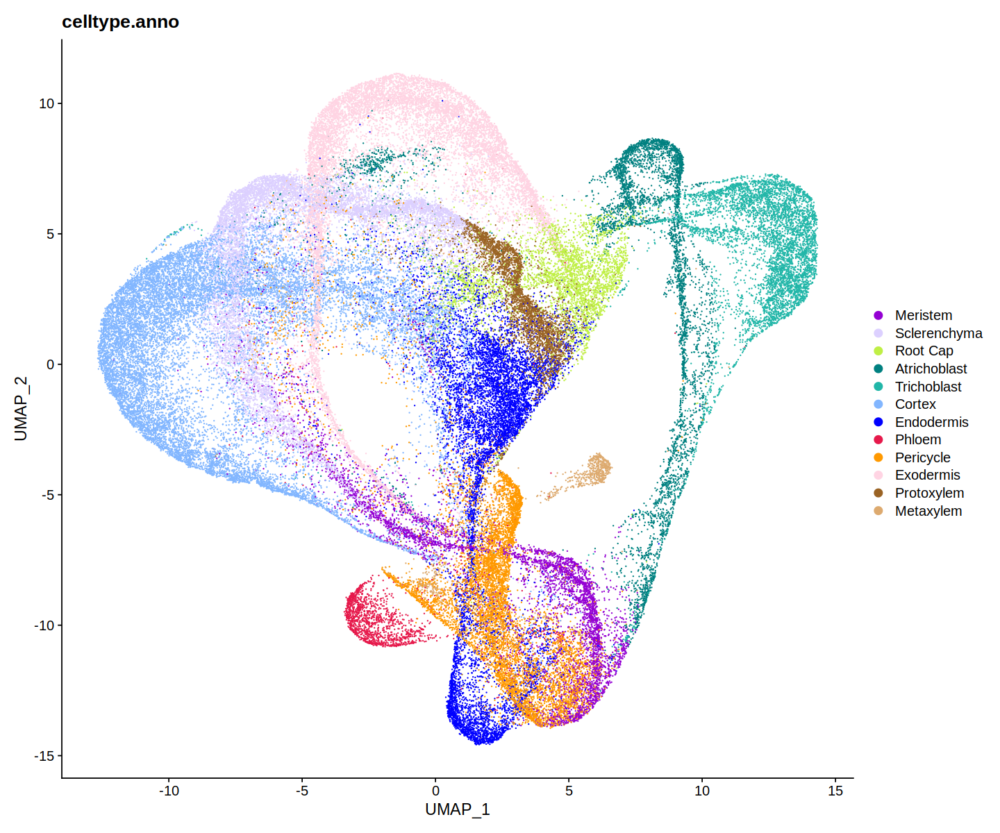

In [99]:
order <- c("Meristem", "Sclerenchyma", "Columella", "Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Vascular Tissue","Pericycle","Exodermis","Epidermis", "Protoxylem", "Metaxylem", "Unknown")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#dd77ec", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$celltype.anno <- factor(rc.integrated$celltype.anno , levels = order[sort(match(unique(rc.integrated$celltype.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$celltype.anno),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.anno", cols = color)+ggtitle("celltype.anno")

In [100]:
rc.integrated$time.anno <-  gsub("_.*$","",as.character(rc.integrated$final.anno.P))

In [101]:
table(rc.integrated$time.anno)


Elongation Maturation   Meristem   Root Cap 
     36589      34421       5009       3724 

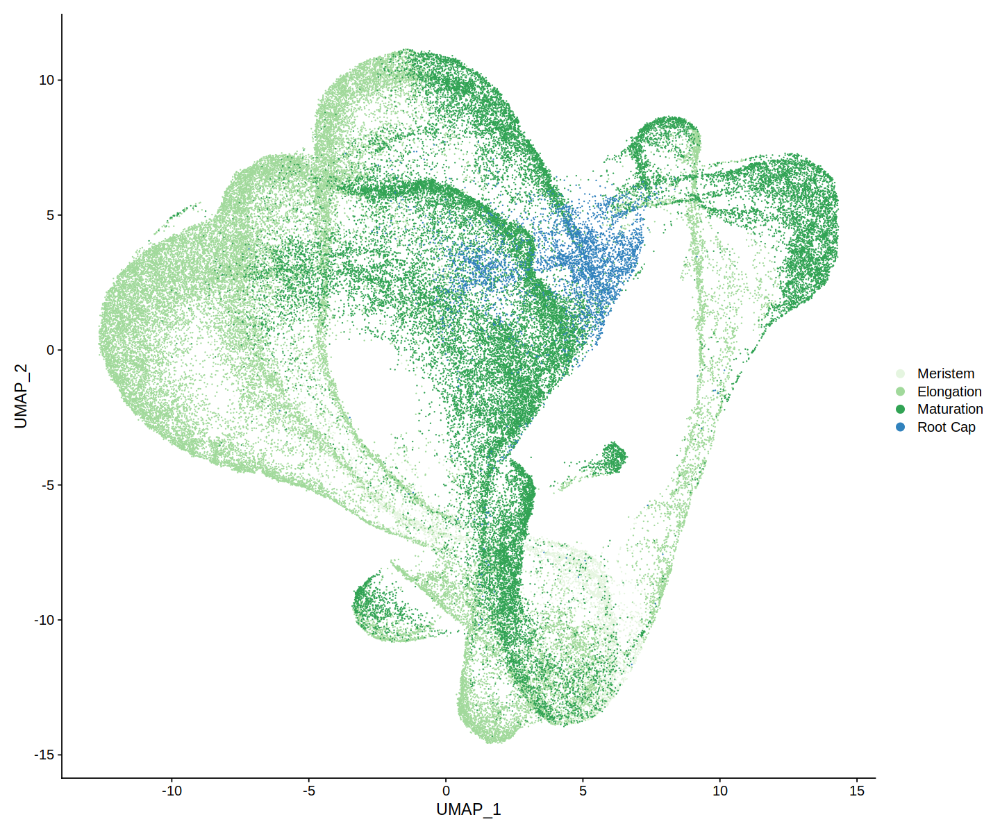

In [102]:
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "time.anno",order = c("Root Cap","Maturation","Elongation","Meristem"),cols = c("#e5f5e0", "#a1d99b", "#31a354", "#3182bd"))

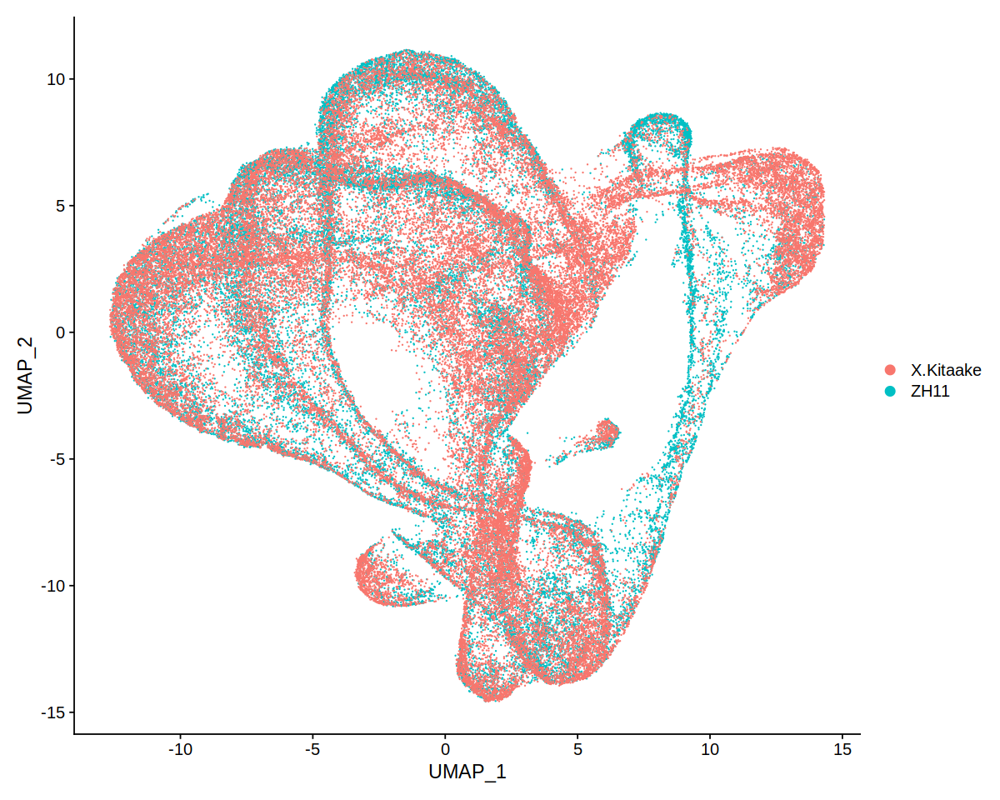

In [103]:
options(repr.plot.width=10, repr.plot.height=8)
DimPlot(rc.integrated, reduction = "umap", group.by = "geno")

## Correlation annotation round 2

In [104]:
rc.integrated$new_ref <- paste0(rc.integrated$time.anno, "_",rc.integrated$consensus.anno)
rc.integrated$new_ref <- gsub(".*Unknown$","Unknown",rc.integrated$new_ref)
rc.integrated$new_ref <- gsub(".*Root Cap$","Root Cap",rc.integrated$new_ref)
rc.integrated$new_ref <- gsub("^Root Cap_.*","Root Cap",rc.integrated$new_ref)
rc.integrated$new_ref <- gsub("Elongation_Stem cell niche","Unknown",rc.integrated$new_ref)
rc.integrated$new_ref <- gsub("Maturation_Stem cell niche","Unknown",rc.integrated$new_ref)
rc.integrated$new_ref <- gsub("^Meristem.*","Meristem",rc.integrated$new_ref)

In [105]:
table(rc.integrated$new_ref)


Elongation_Atrichoblast       Elongation_Cortex   Elongation_Endodermis 
                   2550                   12273                    1832 
   Elongation_Exodermis    Elongation_Metaxylem    Elongation_Pericycle 
                   5790                     500                    1271 
      Elongation_Phloem Elongation_Sclerenchyma  Elongation_Trichoblast 
                    675                    5404                     229 
Maturation_Atrichoblast       Maturation_Cortex   Maturation_Endodermis 
                   1277                    2233                     406 
   Maturation_Exodermis    Maturation_Metaxylem    Maturation_Pericycle 
                   4324                    1360                    4240 
      Maturation_Phloem   Maturation_Protoxylem Maturation_Sclerenchyma 
                    783                    3598                    2178 
 Maturation_Trichoblast                Meristem                Root Cap 
                   4865                    3122   

In [106]:
#rc.integrated$new_ref <- gsub("Meristem_Vascular Tissue","Unknown",rc.integrated$new_ref)

In [107]:
table(rc.integrated$new_ref)


Elongation_Atrichoblast       Elongation_Cortex   Elongation_Endodermis 
                   2550                   12273                    1832 
   Elongation_Exodermis    Elongation_Metaxylem    Elongation_Pericycle 
                   5790                     500                    1271 
      Elongation_Phloem Elongation_Sclerenchyma  Elongation_Trichoblast 
                    675                    5404                     229 
Maturation_Atrichoblast       Maturation_Cortex   Maturation_Endodermis 
                   1277                    2233                     406 
   Maturation_Exodermis    Maturation_Metaxylem    Maturation_Pericycle 
                   4324                    1360                    4240 
      Maturation_Phloem   Maturation_Protoxylem Maturation_Sclerenchyma 
                    783                    3598                    2178 
 Maturation_Trichoblast                Meristem                Root Cap 
                   4865                    3122   

In [108]:
length(sort(table(rc.integrated$new_ref[which(rc.integrated$new_ref!="Unknown")])))

[1] 21

In [109]:
nnc <- length(sort(table(rc.integrated$new_ref[which(rc.integrated$new_ref!="Unknown")])))

In [110]:
# Extract integrated (batch-corrected) expression matrix
afm <- rc.integrated@assays$integrated@data

# Pool (average) expression values of each grouping
new_ref <- matrix(nrow=nrow(afm), ncol = 0)
for (i in 1:nnc) {
m <- afm[,which(rc.integrated$new_ref==as.character(unique(rc.integrated$new_ref[which(rc.integrated$new_ref!="Unknown")]))[i])]
new_ref <- cbind(new_ref, rowSums(m)/ncol(m))
}
colnames(new_ref) <- as.character(unique(rc.integrated$new_ref[which(rc.integrated$new_ref!="Unknown")]))
gene.var <- apply(new_ref,1,var)

# Select top 200 highly variable genes 
new_ref_sub <- new_ref[names(sort(gene.var,decreasing = TRUE)[1:200]),]

# Merge newly-built reference with atlas

merge.rownames <- function (x,y){
  dat <- merge(x = x, y = y, by = "row.names")
  rownames(dat) <- dat$Row.names
  dat <- dat[,-1]
  return(dat)
}

nr <- Reduce(merge.rownames, list(new_ref_sub,afm)) 
nr <- as.matrix(nr)

In [111]:
colnames(nr)[1:nnc+1]

[1] "Maturation_Sclerenchyma" "Elongation_Exodermis"   
 [3] "Maturation_Exodermis"    "Maturation_Trichoblast" 
 [5] "Maturation_Pericycle"    "Elongation_Sclerenchyma"
 [7] "Elongation_Cortex"       "Maturation_Protoxylem"  
 [9] "Root Cap"                "Maturation_Atrichoblast"
[11] "Maturation_Phloem"       "Elongation_Atrichoblast"
[13] "Maturation_Cortex"       "Elongation_Metaxylem"   
[15] "Meristem"                "Elongation_Phloem"      
[17] "Elongation_Pericycle"    "Maturation_Endodermis"  
[19] "Maturation_Metaxylem"    "Elongation_Trichoblast" 
[21] "AAACCCAAGAATACAC_1"

In [112]:
# Correlation-based annotation using newly-built references
nr_label=colnames(new_ref)
nr_stat <- suppressWarnings(sapply((nnc+1):ncol(nr), function(i) sapply(1:nnc, function(j) cor.test(nr[,i],nr[,j],method = "pearson")[c(3,4)])))
nr_cor <- nr_stat[seq(2,nrow(nr_stat),2),]
nr_pvalue <- nr_stat[seq(1,nrow(nr_stat)-1,2),]                                                                                                        
nr_max <- sapply(1:(ncol(nr)-nnc), function(i) max(as.numeric(nr_cor[,i])))
nr_ident <- sapply(1:(ncol(nr)-nnc), function(i) nr_label[which(as.numeric(nr_cor[,i])==max(as.numeric(nr_cor[,i])))])
nr_maxp <- sapply(1:(ncol(nr)-nnc), function(i) as.numeric(nr_pvalue[,i])[which(as.numeric(nr_cor[,i])==max(as.numeric(nr_cor[,i])))])                     
names(nr_max) <- nr_ident
rc.integrated$final.anno.P <- as.character(nr_ident)
rc.integrated$final.anno.cor.P <- as.numeric(nr_max)
rc.integrated$final.anno.pvalue.P <- as.numeric(nr_maxp)

In [113]:
rc.integrated$celltype.fine.anno <-  gsub("^Meristem_","",gsub("^Elongation_","",gsub("^Maturation_","",as.character(rc.integrated$final.anno.P))))
rc.integrated$celltype.fine.anno <- gsub("Meristem","Stem Cell Niche",rc.integrated$celltype.fine.anno)

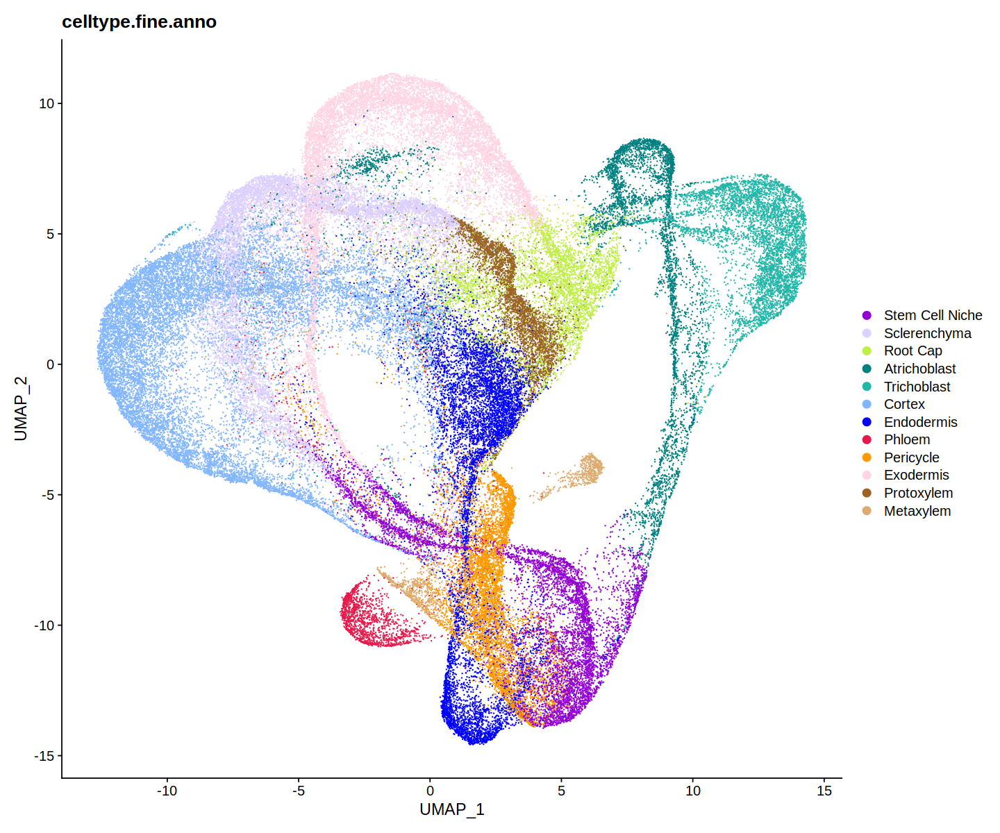

In [114]:
order <- c("Stem Cell Niche", "Sclerenchyma", "Columella", "Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Vascular Tissue","Pericycle","Exodermis","Epidermis", "Protoxylem", "Metaxylem", "Unknown")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#dd77ec", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$celltype.fine.anno <- factor(rc.integrated$celltype.fine.anno , levels = order[sort(match(unique(rc.integrated$celltype.fine.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$celltype.fine.anno),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.fine.anno", cols = color)+ggtitle("celltype.fine.anno")

In [119]:
#rc.integrated$celltype.anno <-  gsub("Late Metaxylem","Xylem",gsub("Early Metaxylem","Xylem",gsub("^Meristem_","",gsub("^Elongation_","",gsub("^Maturation_","",as.character(rc.integrated$final.anno.P))))))
rc.integrated$celltype.anno <-  gsub("^Meristem_","",gsub("^Elongation_","",gsub("^Maturation_","",as.character(rc.integrated$final.anno.P))))
rc.integrated$celltype.anno <- gsub("Meristem","Stem Cell Niche",rc.integrated$celltype.anno)

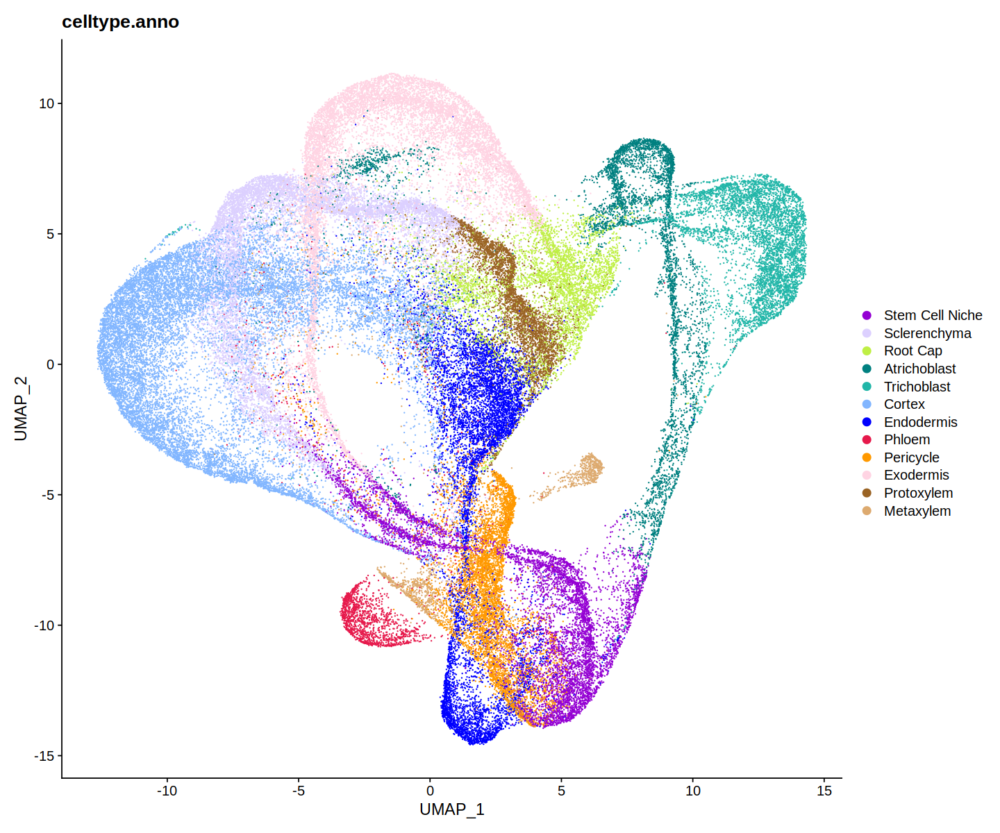

In [120]:
order <- c("Stem Cell Niche", "Sclerenchyma", "Columella", "Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Vascular Tissue","Pericycle","Exodermis","Epidermis", "Protoxylem", "Metaxylem", "Unknown")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#dd77ec", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$celltype.anno <- factor(rc.integrated$celltype.anno , levels = order[sort(match(unique(rc.integrated$celltype.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$celltype.anno),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.anno", cols = color)+ggtitle("celltype.anno")

In [121]:
rc.integrated$time.anno <-  gsub("_.*$","",as.character(rc.integrated$final.anno.P))

In [122]:
table(rc.integrated$time.anno)


Elongation Maturation   Meristem   Root Cap 
     34164      33967       7032       4580 

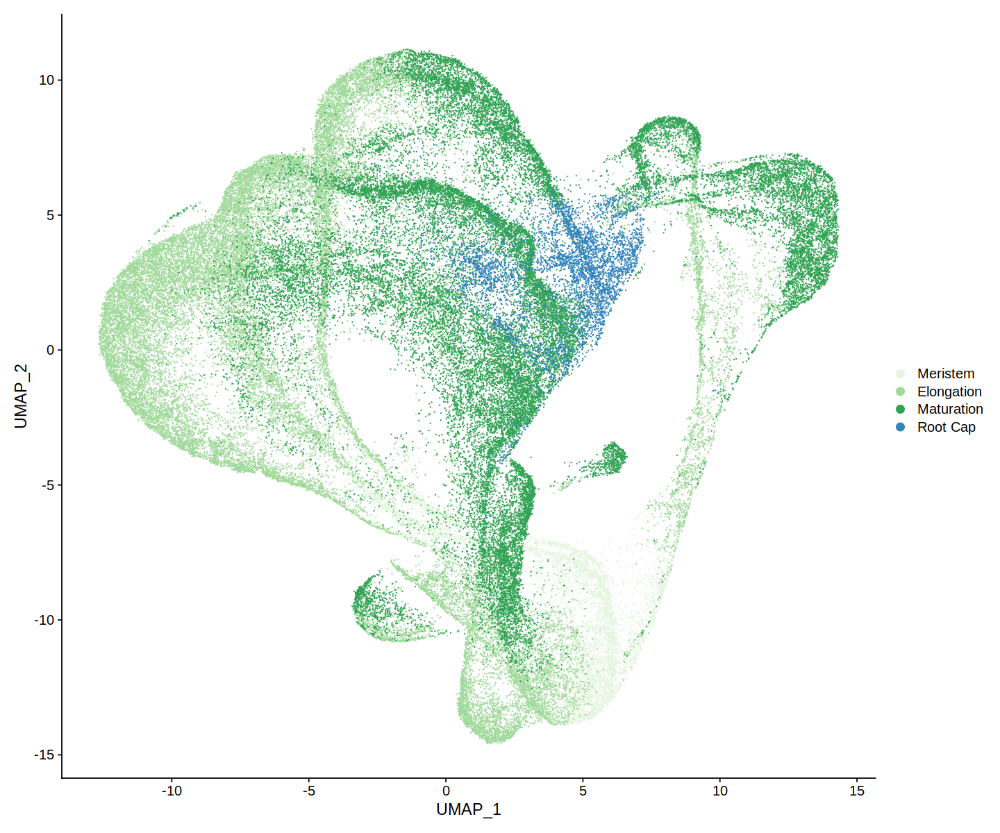

In [123]:
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "time.anno",order = c("Root Cap","Maturation","Elongation","Meristem"),cols = c("#e5f5e0", "#a1d99b", "#31a354", "#3182bd"))

In [125]:
saveRDS(rc.integrated, file = "./scRNA-seq/Integrated_Objects/Rice_12S_WT_atlas_20221117_seu3.rds")

## Compare cell type /time zone proportion

In [126]:
## Celltype
cat("X.Kitaake")
table(rc.integrated$celltype.anno[which(rc.integrated$geno=="X.Kitaake")])/length(which(rc.integrated$geno=="X.Kitaake"))*100
cat("ZH11")
table(rc.integrated$celltype.anno[which(rc.integrated$geno=="ZH11")])/length(which(rc.integrated$geno=="ZH11"))*100
cat("sc_7")
table(rc.integrated$celltype.anno[which(rc.integrated$orig.ident=="sc_7")])/length(which(rc.integrated$orig.ident=="sc_7"))*100
cat("sc_108")
table(rc.integrated$celltype.anno[which(rc.integrated$orig.ident=="sc_108")])/length(which(rc.integrated$orig.ident=="sc_108"))*100
cat("sc_109")
table(rc.integrated$celltype.anno[which(rc.integrated$orig.ident=="sc_109")])/length(which(rc.integrated$orig.ident=="sc_109"))*100
cat("sc_115")
table(rc.integrated$celltype.anno[which(rc.integrated$orig.ident=="sc_115")])/length(which(rc.integrated$orig.ident=="sc_115"))*100
cat("sc_116")
table(rc.integrated$celltype.anno[which(rc.integrated$orig.ident=="sc_116")])/length(which(rc.integrated$orig.ident=="sc_116"))*100
cat("sc_192")
table(rc.integrated$celltype.anno[which(rc.integrated$orig.ident=="sc_192")])/length(which(rc.integrated$orig.ident=="sc_192"))*100
cat("sc_193")
table(rc.integrated$celltype.anno[which(rc.integrated$orig.ident=="sc_193")])/length(which(rc.integrated$orig.ident=="sc_193"))*100
cat("sc_194")
table(rc.integrated$celltype.anno[which(rc.integrated$orig.ident=="sc_194")])/length(which(rc.integrated$orig.ident=="sc_194"))*100
cat("sc_195")
table(rc.integrated$celltype.anno[which(rc.integrated$orig.ident=="sc_195")])/length(which(rc.integrated$orig.ident=="sc_195"))*100
cat("sc_196")
table(rc.integrated$celltype.anno[which(rc.integrated$orig.ident=="sc_196")])/length(which(rc.integrated$orig.ident=="sc_196"))*100
cat("tz1")
table(rc.integrated$celltype.anno[which(rc.integrated$orig.ident=="tz1")])/length(which(rc.integrated$orig.ident=="tz1"))*100
cat("tz2")
table(rc.integrated$celltype.anno[which(rc.integrated$orig.ident=="tz2")])/length(which(rc.integrated$orig.ident=="tz2"))*100

X.Kitaake


Stem Cell Niche    Sclerenchyma        Root Cap    Atrichoblast     Trichoblast 
       7.945118        8.951287        7.945118        3.839609        9.193789 
         Cortex      Endodermis          Phloem       Pericycle       Exodermis 
      21.214635       11.523080        2.646245        9.089555       10.321208 
     Protoxylem       Metaxylem 
       5.479685        1.850670 

ZH11


Stem Cell Niche    Sclerenchyma        Root Cap    Atrichoblast     Trichoblast 
      10.072404       14.337213        2.581493        9.608041        3.528549 
         Cortex      Endodermis          Phloem       Pericycle       Exodermis 
      19.759875        8.309657        1.906333        5.899245       17.312804 
     Protoxylem       Metaxylem 
       4.332020        2.352366 

sc_7


Stem Cell Niche    Sclerenchyma        Root Cap    Atrichoblast     Trichoblast 
       7.199211        6.344510        4.174885        2.103879        2.432610 
         Cortex      Endodermis          Phloem       Pericycle       Exodermis 
      28.172255       15.811966        2.235371       16.699540        6.278764 
     Protoxylem       Metaxylem 
       6.147272        2.399737 

sc_108


Stem Cell Niche    Sclerenchyma        Root Cap    Atrichoblast     Trichoblast 
      10.090090        4.224224        7.027027        6.206206        5.325325 
         Cortex      Endodermis          Phloem       Pericycle       Exodermis 
      18.358358       13.093093        3.443443       17.337337        7.887888 
     Protoxylem       Metaxylem 
       2.562563        4.444444 

sc_109


Stem Cell Niche    Sclerenchyma        Root Cap    Atrichoblast     Trichoblast 
       7.068237        4.378751        4.645477        3.734163       17.626139 
         Cortex      Endodermis          Phloem       Pericycle       Exodermis 
      16.203601       17.826184        2.089353       10.846855        9.402089 
     Protoxylem       Metaxylem 
       3.689709        2.489442 

sc_115


Stem Cell Niche    Sclerenchyma        Root Cap    Atrichoblast     Trichoblast 
       4.614020        2.691511        7.157646       11.446318       38.213546 
         Cortex      Endodermis          Phloem       Pericycle       Exodermis 
      10.677314        4.377403        2.336587        6.891452        7.690033 
     Protoxylem       Metaxylem 
       2.868974        1.035197 

sc_116


Stem Cell Niche    Sclerenchyma        Root Cap    Atrichoblast     Trichoblast 
       4.626060        3.951426        5.223593        4.240555       24.498843 
         Cortex      Endodermis          Phloem       Pericycle       Exodermis 
      19.969160        7.960678        4.548959       14.263685        5.609098 
     Protoxylem       Metaxylem 
       3.893601        1.214341 

sc_192


Stem Cell Niche    Sclerenchyma        Root Cap    Atrichoblast     Trichoblast 
      10.977444       12.511278        9.518797        2.090226        1.849624 
         Cortex      Endodermis          Phloem       Pericycle       Exodermis 
      24.751880       11.969925        2.691729        5.503759       10.240602 
     Protoxylem       Metaxylem 
       6.466165        1.428571 

sc_193


Stem Cell Niche    Sclerenchyma        Root Cap    Atrichoblast     Trichoblast 
      10.951662       12.669940       10.064199        2.228097        1.925982 
         Cortex      Endodermis          Phloem       Pericycle       Exodermis 
      24.546828       10.253021        3.436556        5.777946        9.441088 
     Protoxylem       Metaxylem 
       7.307402        1.397281 

sc_194


Stem Cell Niche    Sclerenchyma        Root Cap    Atrichoblast     Trichoblast 
      7.7039931      11.1545139      13.2378472       2.9947917       0.6510417 
         Cortex      Endodermis          Phloem       Pericycle       Exodermis 
     23.8715278      10.7638889       2.1918403       6.4670139      12.0225694 
     Protoxylem       Metaxylem 
      7.6171875       1.3237847 

sc_195


Stem Cell Niche    Sclerenchyma        Root Cap    Atrichoblast     Trichoblast 
      7.7675968      11.1828405      11.0787172       3.1028738       0.9162849 
         Cortex      Endodermis          Phloem       Pericycle       Exodermis 
     23.5735110      13.0778842       2.2074136       6.7471887      11.6201583 
     Protoxylem       Metaxylem 
      7.4344023       1.2911287 

sc_196


Stem Cell Niche    Sclerenchyma        Root Cap    Atrichoblast     Trichoblast 
       5.715542       16.641020        4.990108        2.462080        7.188393 
         Cortex      Endodermis          Phloem       Pericycle       Exodermis 
      19.674654       10.024181        0.593537        3.165531       21.982853 
     Protoxylem       Metaxylem 
       5.957353        1.604748 

tz1


Stem Cell Niche    Sclerenchyma        Root Cap    Atrichoblast     Trichoblast 
     10.6389636      12.8606296       2.4845109      15.1949434       3.3418862 
         Cortex      Endodermis          Phloem       Pericycle       Exodermis 
     15.5766944       8.5487202       0.7572439       5.6949747      17.6481632 
     Protoxylem       Metaxylem 
      5.6511672       1.6021028 

tz2


Stem Cell Niche    Sclerenchyma        Root Cap    Atrichoblast     Trichoblast 
       9.532052       15.745494        2.673988        4.279575        3.706578 
         Cortex      Endodermis          Phloem       Pericycle       Exodermis 
      23.749552        8.081652        3.002268        6.094067       16.992957 
     Protoxylem       Metaxylem 
       3.073893        3.067924 

In [127]:
## Timezone
cat("X.Kitaake")
table(rc.integrated$time.anno[which(rc.integrated$geno=="X.Kitaake")])/length(which(rc.integrated$geno=="X.Kitaake"))*100
cat("ZH11")
table(rc.integrated$time.anno[which(rc.integrated$geno=="ZH11")])/length(which(rc.integrated$geno=="ZH11"))*100
cat("sc_7")
table(rc.integrated$time.anno[which(rc.integrated$orig.ident=="sc_7")])/length(which(rc.integrated$orig.ident=="sc_7"))*100
cat("sc_108")
table(rc.integrated$time.anno[which(rc.integrated$orig.ident=="sc_108")])/length(which(rc.integrated$orig.ident=="sc_108"))*100
cat("sc_109")
table(rc.integrated$time.anno[which(rc.integrated$orig.ident=="sc_109")])/length(which(rc.integrated$orig.ident=="sc_109"))*100
cat("sc_115")
table(rc.integrated$time.anno[which(rc.integrated$orig.ident=="sc_115")])/length(which(rc.integrated$orig.ident=="sc_115"))*100
cat("sc_116")
table(rc.integrated$time.anno[which(rc.integrated$orig.ident=="sc_116")])/length(which(rc.integrated$orig.ident=="sc_116"))*100
cat("sc_192")
table(rc.integrated$time.anno[which(rc.integrated$orig.ident=="sc_192")])/length(which(rc.integrated$orig.ident=="sc_192"))*100
cat("sc_193")
table(rc.integrated$time.anno[which(rc.integrated$orig.ident=="sc_193")])/length(which(rc.integrated$orig.ident=="sc_193"))*100
cat("sc_194")
table(rc.integrated$time.anno[which(rc.integrated$orig.ident=="sc_194")])/length(which(rc.integrated$orig.ident=="sc_194"))*100
cat("sc_195")
table(rc.integrated$time.anno[which(rc.integrated$orig.ident=="sc_195")])/length(which(rc.integrated$orig.ident=="sc_195"))*100
cat("sc_196")
table(rc.integrated$time.anno[which(rc.integrated$orig.ident=="sc_196")])/length(which(rc.integrated$orig.ident=="sc_196"))*100
cat("tz1")
table(rc.integrated$time.anno[which(rc.integrated$orig.ident=="tz1")])/length(which(rc.integrated$orig.ident=="tz1"))*100
cat("tz2")
table(rc.integrated$time.anno[which(rc.integrated$orig.ident=="tz2")])/length(which(rc.integrated$orig.ident=="tz2"))*100

X.Kitaake


Elongation Maturation   Meristem   Root Cap 
 38.162093  45.947671   7.945118   7.945118 

ZH11


Elongation Maturation   Meristem   Root Cap 
 49.564660  37.781444  10.072404   2.581493 

sc_7


Elongation Maturation   Meristem   Root Cap 
 36.653517  51.972387   7.199211   4.174885 

sc_108


Elongation Maturation   Meristem   Root Cap 
 40.360360  42.522523  10.090090   7.027027 

sc_109


Elongation Maturation   Meristem   Root Cap 
 39.430985  48.855301   7.068237   4.645477 

sc_115


Elongation Maturation   Meristem   Root Cap 
 30.700976  57.527359   4.614020   7.157646 

sc_116


Elongation Maturation   Meristem   Root Cap 
 31.013878  59.136469   4.626060   5.223593 

sc_192


Elongation Maturation   Meristem   Root Cap 
 40.000000  39.503759  10.977444   9.518797 

sc_193


Elongation Maturation   Meristem   Root Cap 
  39.59592   39.38822   10.95166   10.06420 

sc_194


Elongation Maturation   Meristem   Root Cap 
 37.955729  41.102431   7.703993  13.237847 

sc_195


Elongation Maturation   Meristem   Root Cap 
 36.901291  44.252395   7.767597  11.078717 

sc_196


Elongation Maturation   Meristem   Root Cap 
 46.383821  42.910530   5.715542   4.990108 

tz1


Elongation Maturation   Meristem   Root Cap 
 45.816384  41.060141  10.638964   2.484511 

tz2


Elongation Maturation   Meristem   Root Cap 
 53.139549  34.654411   9.532052   2.673988 

## CytoTRACE

In [62]:
pseudotime <- read.csv("./rice_ct_psudotime_SCT.csv")

In [63]:
rc.integrated$ct_pseudotime <- pseudotime$ct_pseudotime

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



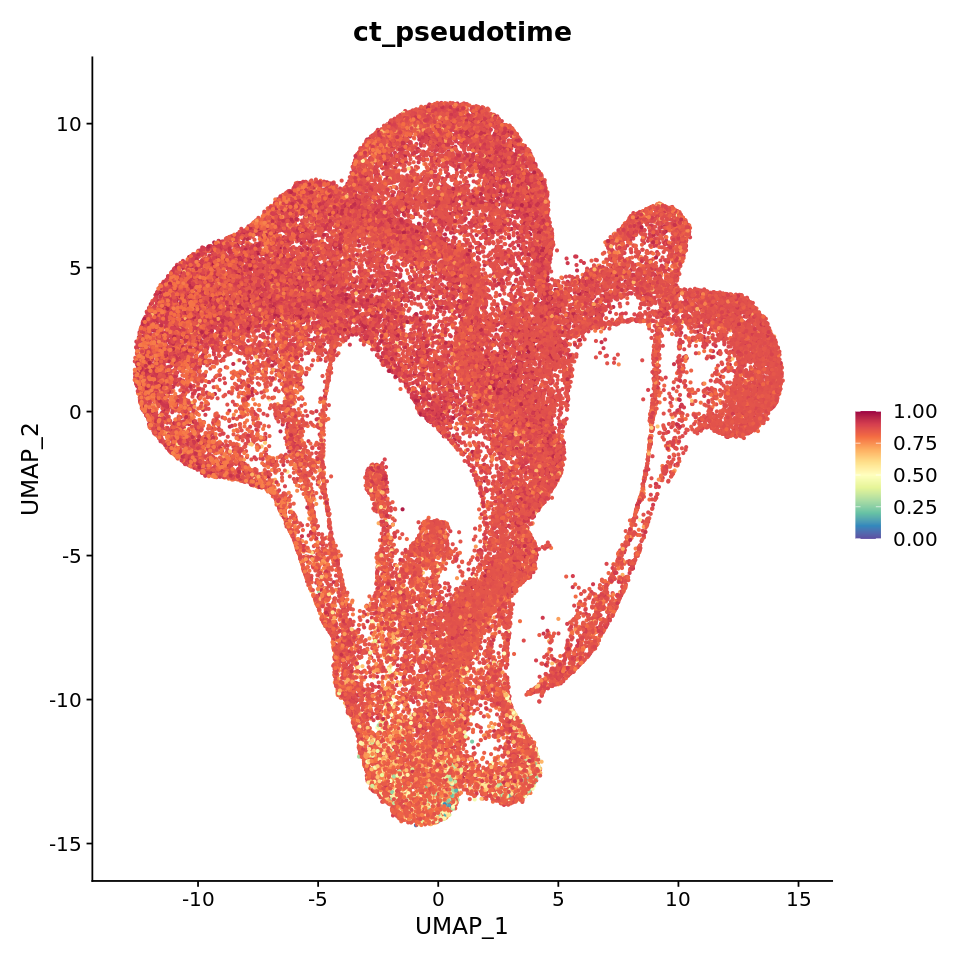

In [64]:
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, features = "ct_pseudotime", pt.size=0.5)+ scale_colour_gradientn(colours = rev(brewer.pal(11,"Spectral")))

In [65]:
df <- data.frame(celltype.anno = rc.integrated$celltype.anno, ct_pseudotime=rc.integrated$ct_pseudotime, pseudotime.group=rep("Unknown", ncol(rc.integrated)))

In [68]:
for (i in unique(df$celltype.anno)){
    if (i == "Stem Cell Niche") {
        df$pseudotime.group[which(df$celltype.anno==i)] <- "T0"
    } else {
        df$pseudotime.group[which(df$celltype.anno==i)] <- as.character(bin(df$ct_pseudotime[which(df$celltype.anno==i)], nbins=9, labels = paste0("T",seq(1,9,1)), method = "content")) 
    }
}

In [69]:
rc.integrated$pseudotime.group <- df$pseudotime.group

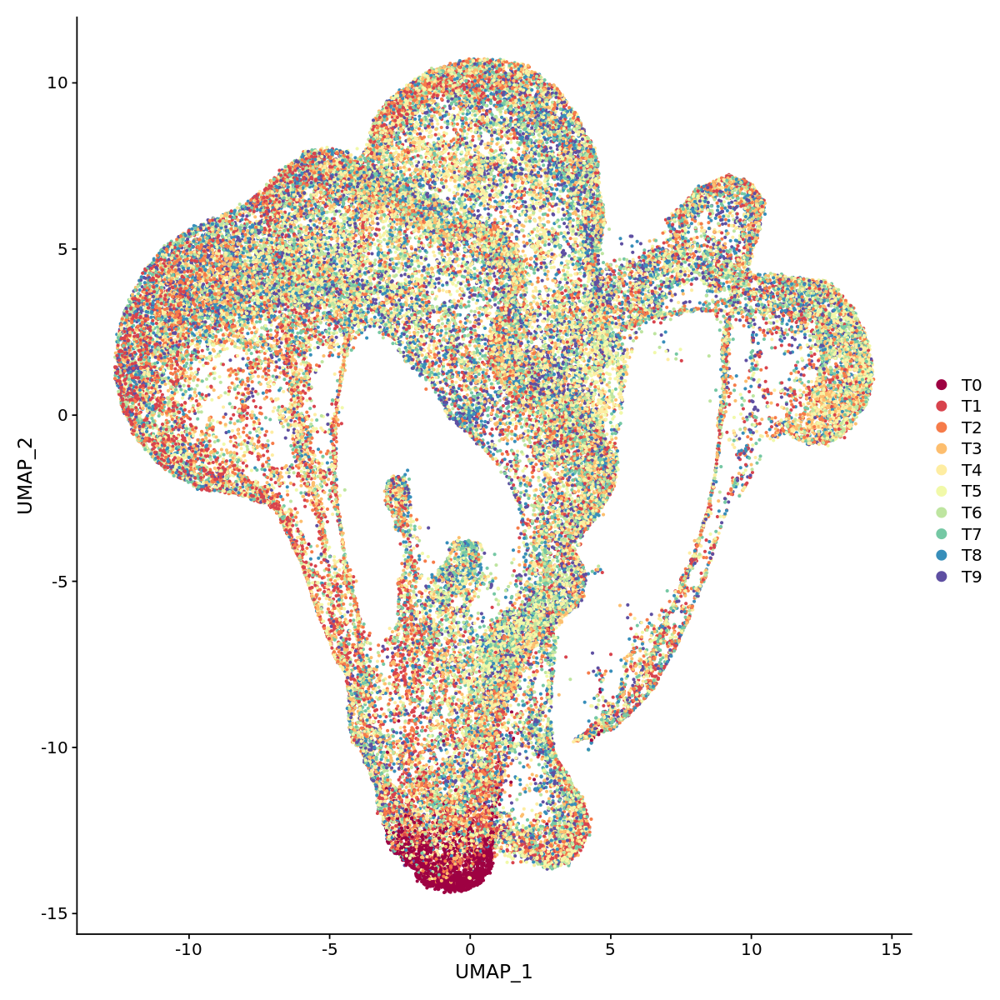

In [70]:
# Plot pseudotime group
nb.cols <- 10
mycolors <- colorRampPalette(brewer.pal(11, "Spectral"))(nb.cols)
order <- paste0("T",seq(0,9,1))
rc.integrated$pseudotime.group <- factor(rc.integrated$pseudotime.group, levels = order[sort(match(unique(rc.integrated$pseudotime.group),order))]) 
color <- mycolors[sort(match(unique(rc.integrated$pseudotime.group),order))]
options(repr.plot.width=10, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "pseudotime.group", pt.size=0.5, cols=color)

## 3D UMAP

In [128]:
suppressMessages(library(plotly))

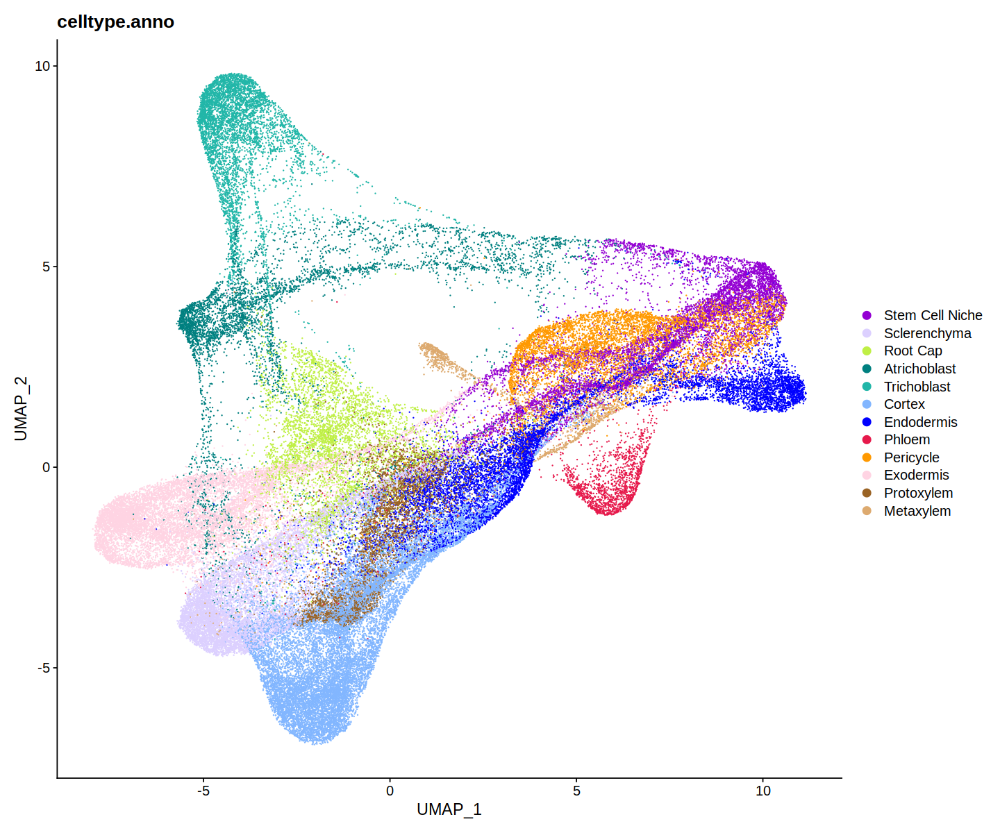

In [129]:
options(repr.plot.width=8, repr.plot.height=8)
rc.integrated@reductions$umap_2D <- rc.integrated@reductions$umap
rc.integrated@reductions$umap <- rc.integrated@reductions$umap_3D
order <- c("Stem Cell Niche", "Sclerenchyma", "Columella", "Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Vascular Tissue","Pericycle","Exodermis","Epidermis", "Protoxylem", "Metaxylem", "Unknown")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#dd77ec", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$celltype.anno <- factor(rc.integrated$celltype.anno , levels = order[sort(match(unique(rc.integrated$celltype.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$celltype.anno),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.anno", cols = color)+ggtitle("celltype.anno")

In [130]:
u3 <- rc.integrated@reductions$umap@cell.embeddings[,1]
u1 <- rc.integrated@reductions$umap@cell.embeddings[,3]
rc.integrated@reductions$umap@cell.embeddings[,1] <- u1
rc.integrated@reductions$umap@cell.embeddings[,3] <- u3

In [131]:
int.name <- "Rice_Atlas"

In [134]:
rc.integrated@reductions$umap@cell.embeddings[,3] <- -rc.integrated@reductions$umap@cell.embeddings[,3]

In [135]:
# Make sure that the color match to the label it is supposed to color 
umap_1 <- rc.integrated[["umap"]]@cell.embeddings[,1]
umap_2 <- rc.integrated[["umap"]]@cell.embeddings[,2]
umap_3 <- rc.integrated[["umap"]]@cell.embeddings[,3]


# Prepare data for plotting
plot.data <- FetchData(object = rc.integrated, vars = c("UMAP_1", "UMAP_2", "UMAP_3", "celltype.anno", "time.anno", "orig.ident"))

# Make a column of row name identities (these will be your cell/barcode names)
plot.data$label <- paste(plot.data$orig.ident)

order <- c("Stem Cell Niche", "Sclerenchyma", "Columella", "Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Vascular Tissue","Pericycle","Exodermis","Epidermis", "Protoxylem", "Metaxylem", "Unknown")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#dd77ec", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$celltype.anno <- factor(rc.integrated$celltype.anno, levels = order[sort(match(unique(rc.integrated$celltype.anno),order))])
color <- palette[sort(match(unique(rc.integrated$celltype.anno),order))]
p <- plot_ly(data = plot.data, 
        x = ~UMAP_1, y = ~UMAP_2, z = ~UMAP_3, 
        color = ~celltype.anno, 
        colors = color,
        type = "scatter3d", 
        mode = "markers", 
        marker = list(size = 3, width=2), # controls size of points
        text=~label, #This is that extra column we made earlier for which we will use for cell ID
        hoverinfo="text") #When you visualize your plotly object, hovering your mouse pointer over a point shows cell names
htmlwidgets::saveWidget(p, paste0(int.name,"_celltype.anno.html"))

order <- c("Maturation","Elongation","Meristem","Root Cap")
palette <- c("#31a354", "#a1d99b", "#e5f5e0", "#3182bd")
rc.integrated$time.anno <- factor(rc.integrated$time.anno, levels = order[sort(match(unique(rc.integrated$time.anno),order))])
color <- palette[sort(match(unique(rc.integrated$time.anno),order))]
p <- plot_ly(data = plot.data, 
        x = ~UMAP_1, y = ~UMAP_2, z = ~UMAP_3, 
        color = ~time.anno, 
        colors = color,
        type = "scatter3d", 
        mode = "markers", 
        marker = list(size = 3, width=2), # controls size of points
        text=~label, #This is that extra column we made earlier for which we will use for cell ID
        hoverinfo="text") #When you visualize your plotly object, hovering your mouse pointer over a point shows cell names
htmlwidgets::saveWidget(p, paste0(int.name,"_time.anno.html"))

Warning message in `[[.DimReduc`(object[[x]], cells, vars.use, drop = FALSE):
“The following embeddings are not present: UMAP_3”


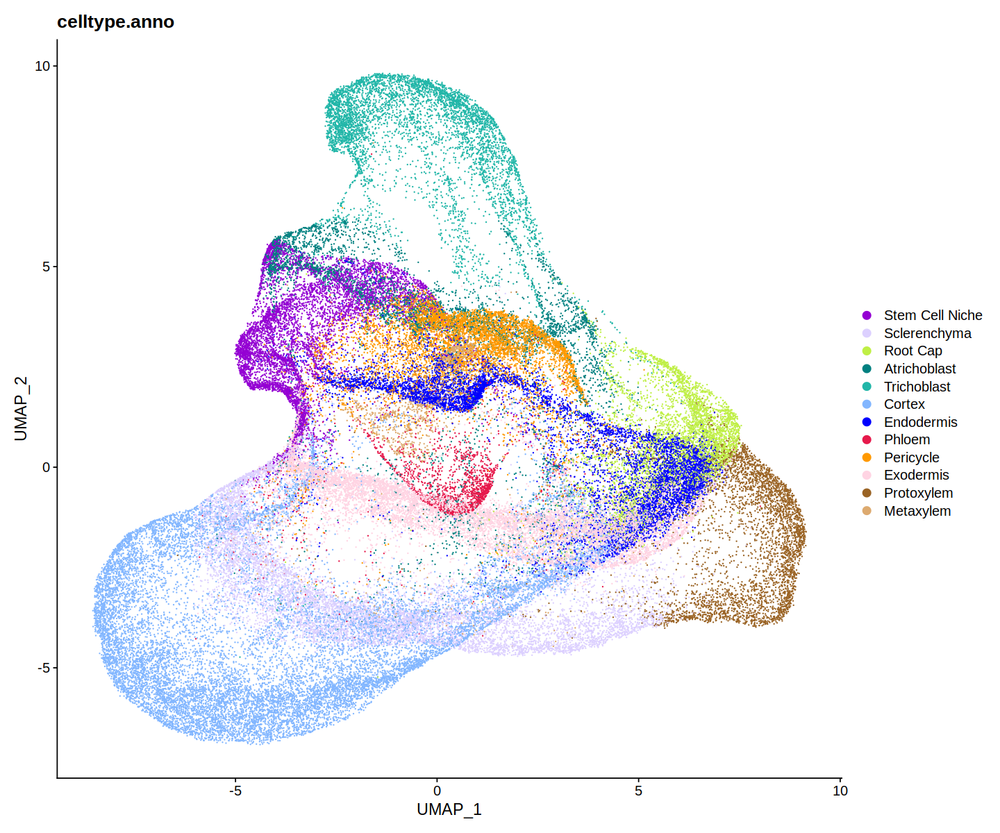

In [133]:
options(repr.plot.width=8, repr.plot.height=8)
order <- c("Stem Cell Niche", "Sclerenchyma", "Columella", "Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Vascular Tissue","Pericycle","Exodermis","Epidermis", "Protoxylem", "Metaxylem", "Unknown")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#dd77ec", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$celltype.anno <- factor(rc.integrated$celltype.anno , levels = order[sort(match(unique(rc.integrated$celltype.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$celltype.anno),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.anno", cols = color)+ggtitle("celltype.anno")

In [77]:
rc.integrated@reductions$umap <- rc.integrated@reductions$umap_2D

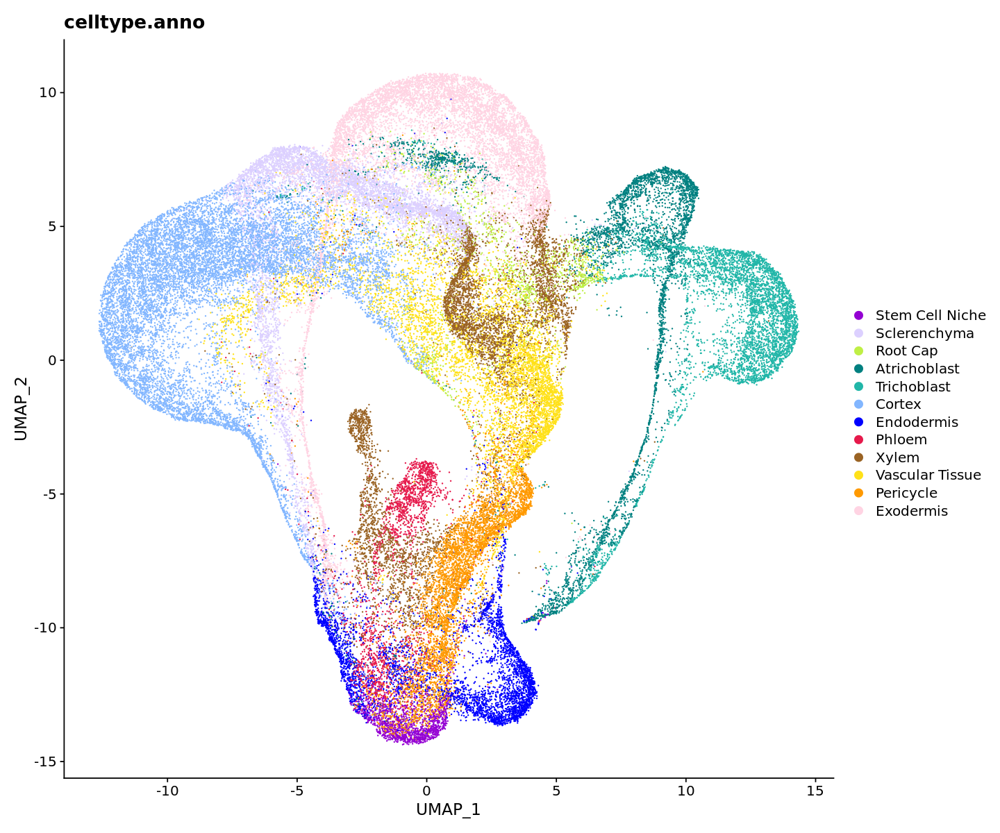

In [78]:
options(repr.plot.width=8, repr.plot.height=8)
order <- c("Stem Cell Niche", "Sclerenchyma", "Columella", "Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Vascular Tissue","Pericycle","Exodermis","Epidermis", "Early Metaxylem", "Late Metaxylem", "Unknown")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#dd77ec", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$celltype.anno <- factor(rc.integrated$celltype.anno , levels = order[sort(match(unique(rc.integrated$celltype.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$celltype.anno),order))]
options(repr.plot.width=12, repr.plot.height=10)
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.anno", cols = color)+ggtitle("celltype.anno")

## Save

In [79]:
saveRDS(rc.integrated, file = "./Rice_Atlas_12WT_ref_tz2_seu3.rds")

## Label Transfer

In [26]:
rc.integrated <- readRDS("./Rice_Atlas_12WT_ref_tz2_seu3.rds")

In [27]:
rc.integrated <- UpdateSeuratObject(rc.integrated)

Validating object structure

Updating object slots

Ensuring keys are in the proper strucutre

Ensuring feature names don't have underscores or pipes

Object representation is consistent with the most current Seurat version



In [28]:
DefaultAssay(rc.integrated) <- "integrated"

In [36]:
rc.integrated

An object of class Seurat 
88280 features across 44144 samples within 3 assays 
Active assay: integrated (16838 features, 16838 variable features)
 2 other assays present: RNA, SCT
 5 dimensional reductions calculated: pca, umap, umap_50, umap_3D, umap_2D

In [ ]:
# Need to change the directory accordingly 
label_transfer_init <- function(sample.name){
    seu <-read_seu(dir = paste0("../COPILOT_RDS_LENIENT_DR/",sample.name,"_COPILOT.rds"))
    lt.anchors <- FindTransferAnchors(reference = rc.integrated, query = seu, normalization.method = "SCT", npcs = 50 ,dims = 1:50, features = intersect(rownames(rc.integrated),rownames(seu)))
    predictions <- TransferData(anchorset = lt.anchors, refdata = rc.integrated$celltype.anno, dims = 1:50, weight.reduction = "pcaproject")
    seu <- AddMetaData(seu, metadata = predictions)
    seu@meta.data$celltype.anno <- seu@meta.data$predicted.id
    predictions <- TransferData(anchorset = lt.anchors, refdata = rc.integrated$time.anno, dims = 1:50, weight.reduction = "pcaproject")
    seu <- AddMetaData(seu, metadata = predictions)
    seu@meta.data$time.anno <- seu@meta.data$predicted.id
    saveRDS(seu, file = paste0("../COPILOT_RDS_LENIENT_DR/",sample.name,"_COPILOT.rds"))
}

In [ ]:
#sample.list <- c("sc_12", "sc_17", "sc_35", "sc_57", "sc_58", "sc_59", "sc_60", "sc_61", "sc_62", "sc_63", "sc_64", "sc_66")
sample.list <- c("sc_192", "sc_193", "sc_194", "sc_195", "sc_199", "sc_200", "sc_201", "sc_202")

In [ ]:
for (i in 1:length(sample.list)){
 label_transfer_init(sample.list[i])
}